<a href="https://colab.research.google.com/github/meichenfang/Poisson-regression/blob/main/demos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font size="+4"><center> Demonstrations </center></font> 

# Load packages

In [1]:
%cd ..

# Load before numpy to restrict its usage of cores, otherwise it will use all cores when doing @
import os
os.environ["BLAS_NUM_THREADS"] = "1" 
os.environ["OPENBLAS_NUM_THREADS"] = "1" # 

import RADOM
print(RADOM.__version__)

from RADOM.inference import Trajectory
from RADOM.poisson_mixture import PoissonMixture
from RADOM.gamma_poisson_mixture import GammaPoissonMixture
from RADOM.preprocess import *
from RADOM.plotting import *

/home/mffang/workspace/Poisson-regression
2023.04.24.19


In [2]:
import numpy as np
import pickle
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy import stats
import copy
import time

In [3]:
%cd simulations/simulation_results
results_dir = 'two_species_ss/'

if not os.path.exists(results_dir):
    os.makedirs(results_dir)

/home/mffang/workspace/Poisson-regression/simulations/simulation_results


In [4]:
from RADOM.models.two_species_ss import get_Y

def simulate_data(topo, tau, n, p, t_samples=None, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0, logu_mu=0, logu_sd=0, random_seed=2023, loomfilepath=None):    
    np.random.seed(random_seed)
    L=len(topo)
    K=len(tau)-1
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=100*n)
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Y = np.zeros((n*L,p,2))
    for l in range(L):
        theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
        t = np.random.choice(t_samples,size=n)
        Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
        true_t = np.append(true_t,t)
    
    if logu_sd != 0:
        Ubias = np.random.lognormal(logu_mu,logu_sd,p)
        Y[:,:,0] *= Ubias[None,:]
    else:
        Ubias = 1
        
    if rd_var != 0:
        read_depth = np.random.gamma(1/rd_var,1/rd_var,n*L)
        rd = read_depth/read_depth.mean()
        X = np.random.poisson(rd[:,None,None]*Y)
    else:
        rd = np.ones(n*L)
        X = np.random.poisson(Y)
    
    fig, ax = plt.subplots(1,5,figsize=(30,4))
    ax[0].hist(theta[:,:-2].flatten(),bins=100)
    ax[0].set_title("α")
    ax[1].hist(theta[:,-2:].flatten(),bins=10)
    ax[1].set_title("β and γ")
    ax[2].hist(rd,bins=100)
    ax[2].set_title("read depth")
    ax[3].hist(Ubias,bins=100)
    ax[3].set_title("U/S bias")
    ax[4].hist(true_t,bins=100)
    ax[4].set_title("t")
    
    if loomfilepath is not None:
        adata=ad.AnnData(np.sum(X,axis=-1))
        adata.layers["spliced"] = X[:,:,1]
        adata.layers["unspliced"] = X[:,:,0]
        adata.layers["ambiguous"]=np.zeros_like(X[:,:,0])
        adata.obs["time"]=true_t
        adata.obs["celltype"]=topo[(np.arange(n*L)//n),np.array(true_t*K/tau[-1],dtype=int)]
        adata.obs["read_depth"]=read_depth
        adata.uns["theta"]=theta
        adata.var["true_beta"]=theta[:,-2]
        adata.var["true_gamma"]=theta[:,-1]
        adata.var["U_bias"]=Ubias
        adata.write_loom(loomfilepath)
    return theta, true_t, Y, X, rd, Ubias

# Identifying potential causes of model failure by varying parameters and adding unmodeled noise

## Functions

In [234]:
from multiprocessing import Pool

def fit_wrapper(X,topo_,tau_,true_t,theta,m,n_init,params,fit_tau=False):
    traj = Trajectory(topo=topo_, tau=tau_, model="two_species_ss")
    traj.fit(X,m=m,n_init=n_init,params=params,fit_tau=fit_tau,perm_theta=False,epoch=100,parallel=False)   
    traj.true_t = true_t
    traj.true_theta = theta
    
    return traj

In [72]:
plt.rcParams['font.size'] = '24'
label_font = '36'

In [361]:
def plot_vary_results(picklefile,xs,K=3,logscale=True,Ub_correct=False):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    assert len(results)//K == len(xs)
    
    p,n_theta = results[-1].theta.shape
    CCCs = np.zeros((len(results)//K,K,n_theta+1))
    MAPE = np.zeros((len(results)//K,K,p,n_theta))#Mean Absolute Percentage Error
    
    for i in range(len(results)):
        traj = results[i]
        true_theta = traj.true_theta.copy()
        Q = traj.Q
        p,n_theta = traj.theta.shape
        
        if len(traj.topo)==2:
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                true_theta[:,topo[0]] = traj.true_theta[:,topo[1]]
                true_theta[:,topo[1]] = traj.true_theta[:,topo[0]]
                
        if 'Ubias' in traj.params and Ub_correct is True:
            true_theta[:,:-2] *= traj.params['Ubias'][:,None]
            true_theta[:,-2] /= traj.params['Ubias']
            
        for j in range(n_theta):
            CCCs[i//K,i%K,j]=CCC(traj.theta[:,j],true_theta[:,j])
            
        CCCs[i//K,i%K,-1]=CCC(np.sum(traj.Q*traj.t[None,None,:],axis=(1,2)),traj.true_t)
        MAPE[i//K,i%K]=np.abs(traj.theta-true_theta)/true_theta*100

    fig, ax = plt.subplots(1,n_theta+1,figsize=((n_theta+1)*6,5),constrained_layout=True)
    for j in range(n_theta+1):
        for k in range(K):
            ax[j].scatter(xs,CCCs[:,k,j],alpha=1);
        ax[j].plot(xs,CCCs[:,:,j].mean(axis=1),alpha=1,color='k');
        if logscale:
            ax[j].set_xscale('log')
        
    for j in range(n_theta-2):
        ax[j].set_title("α"+str(j),fontsize=label_font)
        
    ax[-3].set_title("β",fontsize=label_font)
    ax[-2].set_title("γ",fontsize=label_font)
    ax[-1].set_title("process time",fontsize=label_font)
    
    plt.setp(ax, ylim=(0,1.1));
    fig.supylabel('CCC',fontsize=label_font);
    fig.supxlabel('number of cells',fontsize=label_font);
    
    fig, ax = plt.subplots(1,n_theta,figsize=(n_theta*6,5),constrained_layout=True)
    for j in range(n_theta):
        for pp in range(p):
            for k in range(K):
                ax[j].plot(xs,MAPE[:,k,pp,j],'.-',alpha=0.1);
                ax[j].set_yscale('log')
        ax[j].plot(xs,MAPE[:,:,pp,j].mean(axis=1),color='k',alpha=1);
        if logscale:
            ax[j].set_xscale('log')
    for j in range(n_theta-2):
        ax[j].set_title("α"+str(j),fontsize=label_font)
        
    ax[-2].set_title("β",fontsize=label_font)
    ax[-1].set_title("γ",fontsize=label_font)
    
    fig.supylabel('MAPE',fontsize=label_font);
    fig.supxlabel('number of cells',fontsize=label_font);

    return

In [203]:
def plot_theta_results(picklefile,K=10,Ub_correct=False):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    test = results[0]
    p, n_theta = test.theta.shape
    fig, ax = plt.subplots(len(results)//K,n_theta,figsize=(n_theta*6,len(results)//K*5),constrained_layout=True)

    for i in range(len(results)):
        traj = results[i]
        true_theta = traj.true_theta.copy()
        Q = traj.Q
        N,p,_ = traj.X.shape
        
        if len(traj.topo)==2:
            n = N//2
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                true_theta[:,topo[0]] = traj.true_theta[:,topo[1]]
                true_theta[:,topo[1]] = traj.true_theta[:,topo[0]]
                
        if 'Ubias' in traj.params and Ub_correct is True:
            true_theta[:,:-2] *= traj.params['Ubias'][:,None]
            true_theta[:,-2] /= traj.params['Ubias']
                        
        for j in range(n_theta):
            ax[i//K,j].loglog(true_theta[:,j],traj.theta[:,j],'.');
            ax[i//K,j].loglog(true_theta[:,j],true_theta[:,j],'gray');       
             
            
    for j in range(n_theta-2):
        ax[0,j].set_title("α"+str(j),fontsize=label_font)    

    ax[0,-2].set_title("β",fontsize=label_font)
    ax[0,-1].set_title("γ",fontsize=label_font)
    fig.supxlabel('true value',fontsize=label_font);
    fig.supylabel('estimates',fontsize=label_font);
    return fig

In [311]:
def plot_t_results(picklefile,K=10,verbose=False):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    
    test = results[0]
    L = len(test.topo)
    if hasattr(test,"elbos"):
        if verbose:
            print("n_init = ",len(test.elbos))
        
    fig, axs = plt.subplots(len(results)//K,L*K,figsize=(L*K*6,len(results)//K*5))
    fig2, axs2 = plt.subplots(len(results)//K,L*K,figsize=(L*K*6,len(results)//K*5))
    for i in range(len(results)):
        traj = results[i]
        Q = traj.Q.copy()
        N,p,_ = traj.X.shape
        n = N//L
        
        if L==2:
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                Q[:,0] = traj.Q[:,1]
                Q[:,1] = traj.Q[:,0]

        for l in range(L):
            if L*K == 1:
                ax1=axs[i//K]
                ax2=axs2[i//K]
                
            elif len(results)//K == 1:
                ax1=axs[L*(i%K)+l]
                ax2=axs2[L*(i%K)+l]
            else:
                ax1=axs[i//K,L*(i%K)+l]
                ax2=axs2[i//K,L*(i%K)+l]
                
            plot_t(traj,Q=Q,l=l,ax=ax1,t=traj.true_t,order_cells=True)
            ax2.plot(traj.t,traj.Q.sum(axis=(0,1))*traj.m/n/(traj.tau[-1]-traj.tau[0]),color='r')
            ax2.hist(traj.true_t,bins=traj.t,density=True,color='gray')
            ax2.axhline(0.1,color='gray')
            
    #fig.supxlabel('time grids',fontsize=label_font);
    #fig.supylabel('ordered cells',fontsize=label_font);
    return fig

## Vary n: less than 1000 cells per lineage seems to be not enough

In [221]:
def vary_n(topo, tau, ns=[200,1000,2000,3000,5000,10000], p=200, t_samples=None, parameter_seed=0, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=10*ns[-1])
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i,n in enumerate(ns):             
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
                true_t = np.append(true_t,t)
        
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
                
            X = np.random.poisson(rd[:,None,None]*Y)      
            
            params={'r':rd}
            Input_args.append((X, topo, tau, true_t, theta, m, n_init, params))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

In [222]:
topo = np.array([[0,1]])
tau = (0,1)

results = vary_n(topo, tau, ns=[200,1000,2000,3000,5000], p=200, t_samples=None,\
                 parameter_seed=0, K=3, n_init=10, epoch=100, m=100, cores=15,\
                 loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25)

with open(results_dir+'vary_n_topo_0_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

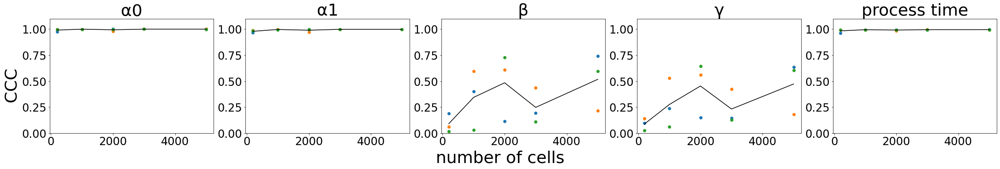

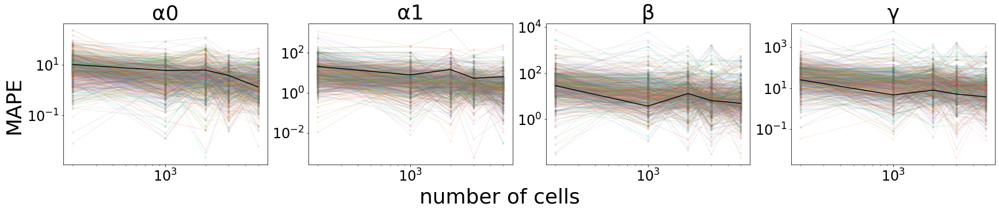

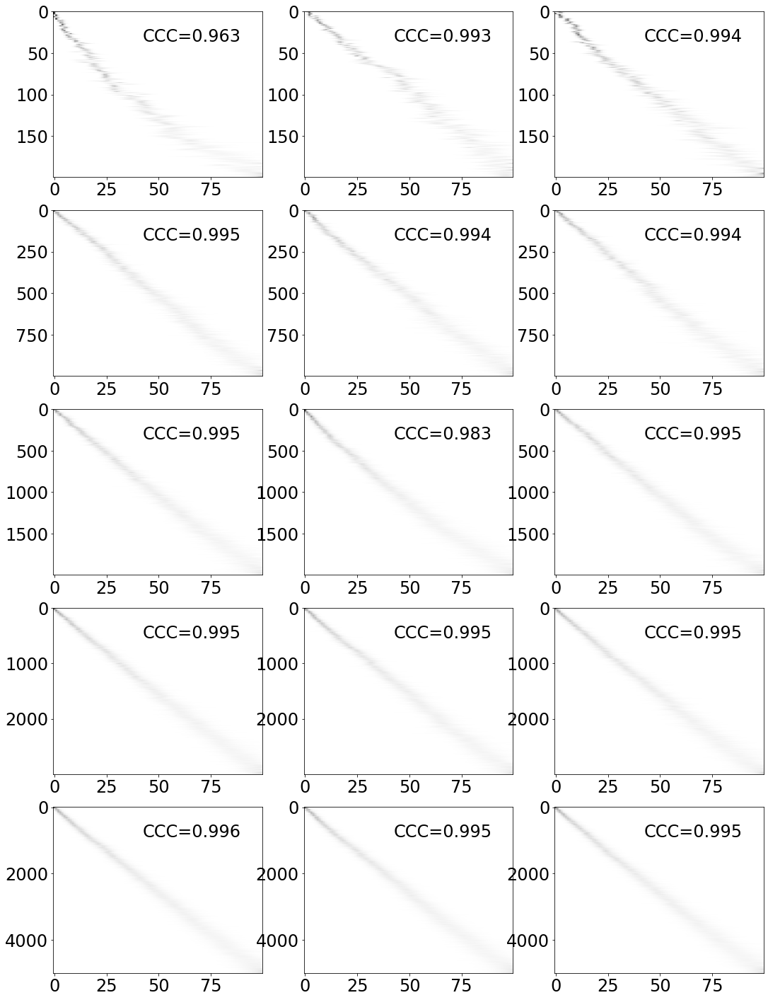

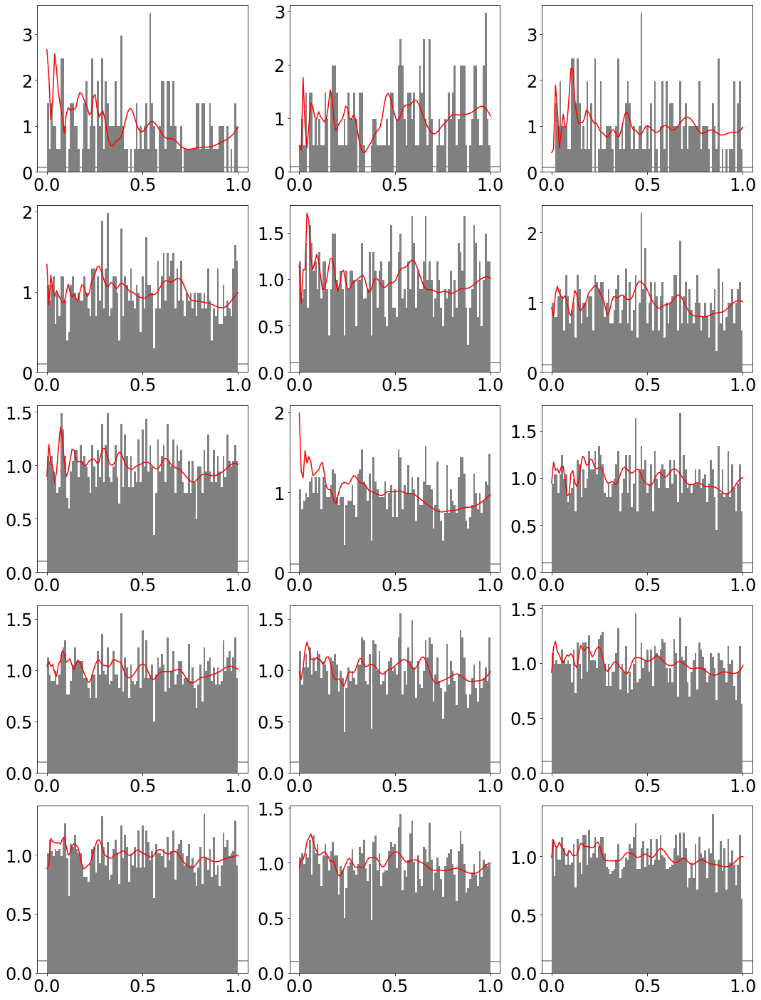

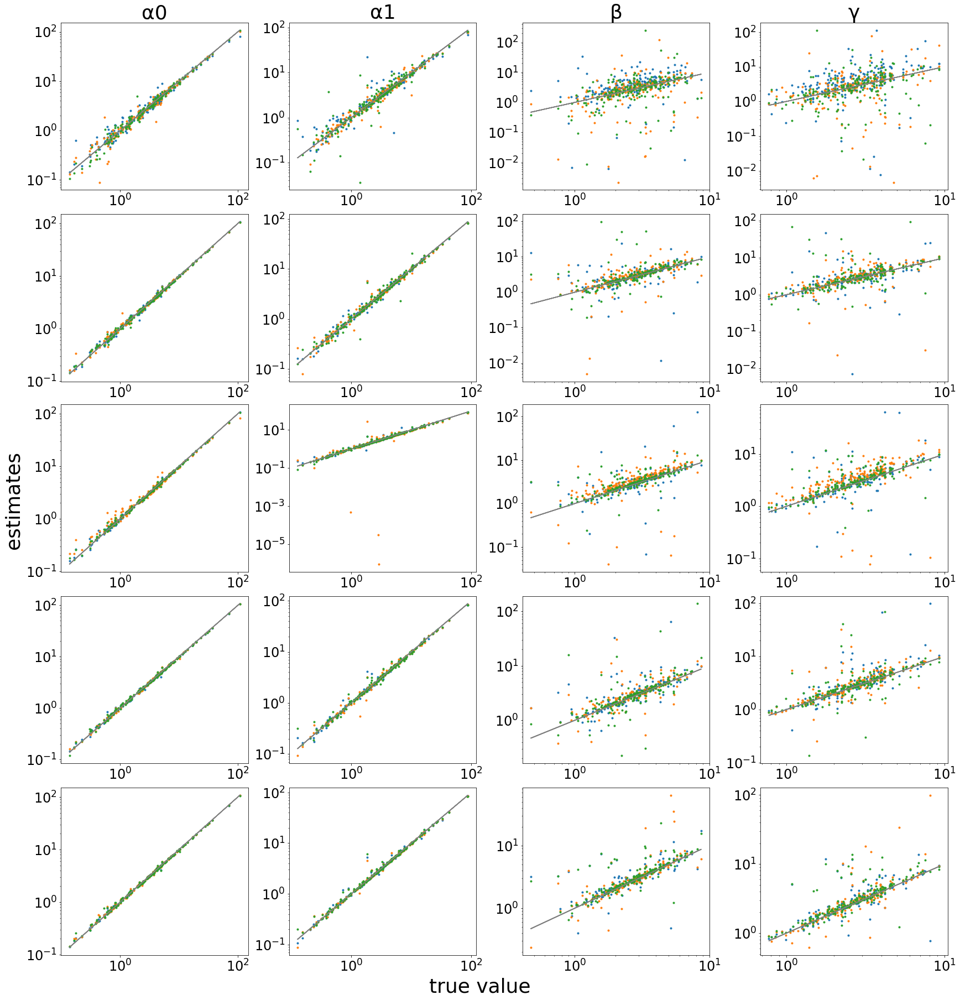

In [357]:
picklefile = results_dir+'vary_n_topo_0_1.pickle'

plot_vary_results(picklefile=picklefile,xs=[200,1000,2000,3000,5000],K=3,logscale=False)
fig = plot_t_results(picklefile,K=3)
fig = plot_theta_results(picklefile,K=3)

In [223]:
topo = np.array([[0,1,2]])
tau = (0,1,2)

results = vary_n(topo, tau, ns=[200,1000,2000,3000,5000], p=200, t_samples=None,\
                 parameter_seed=0, K=3, n_init=10, epoch=100, m=100, cores=15,\
                 loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25)

with open(results_dir+'vary_n_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

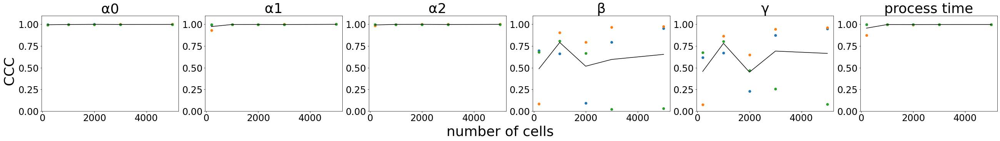

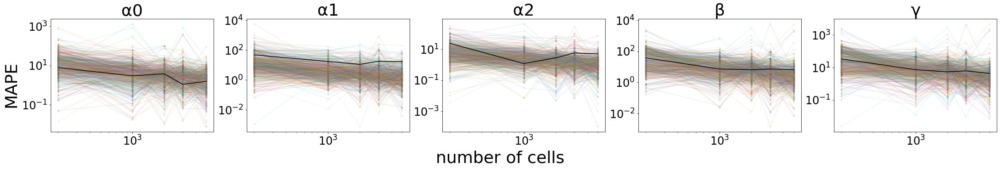

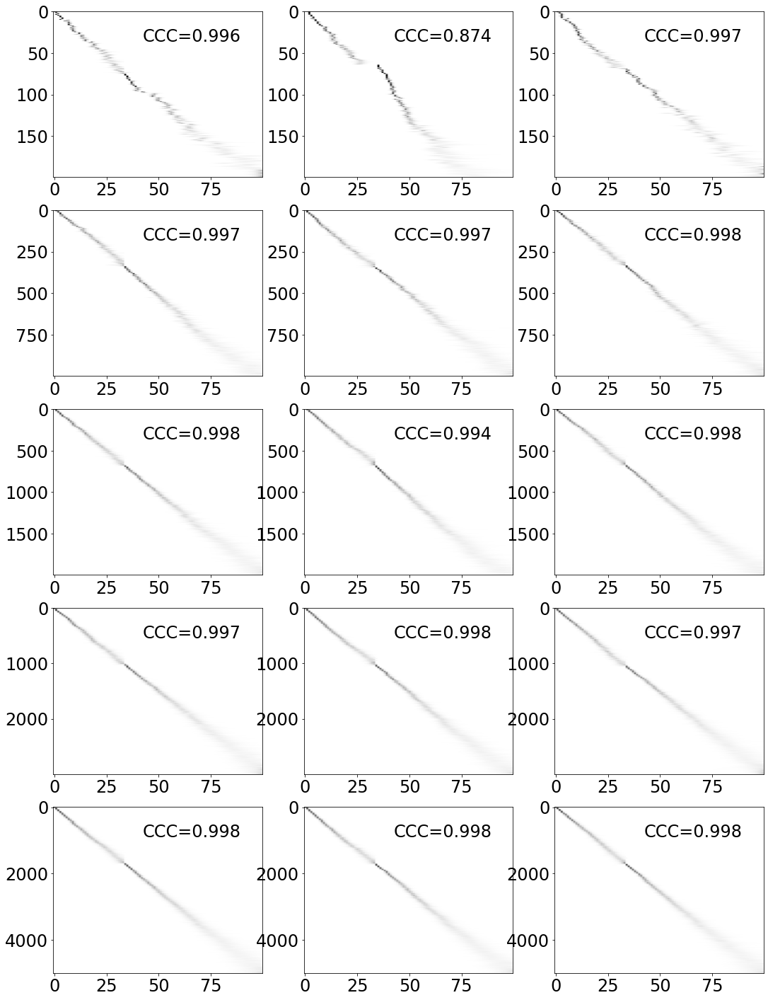

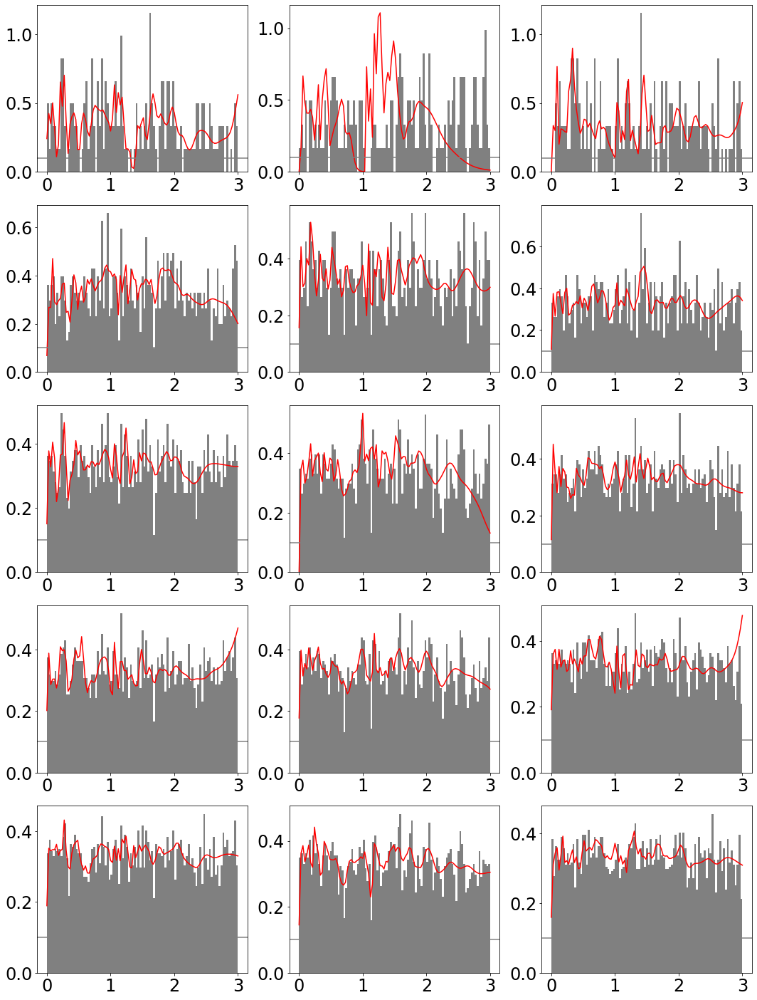

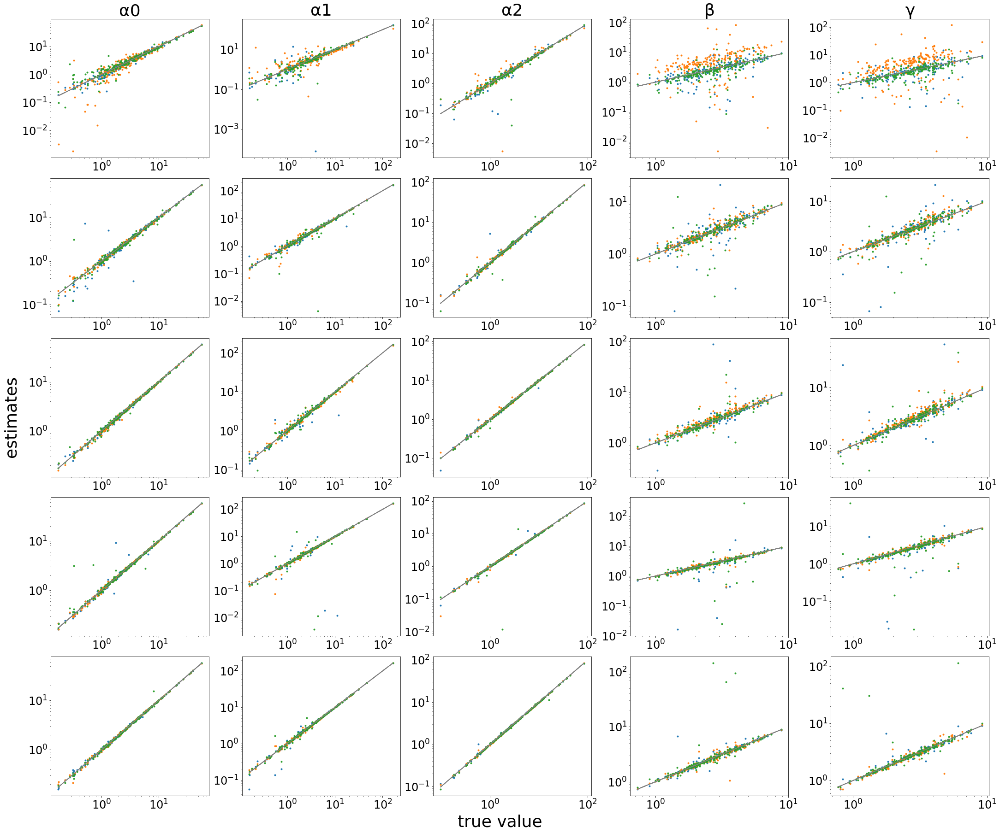

In [358]:
picklefile = results_dir+'vary_n_topo_1_1.pickle'

plot_vary_results(picklefile=picklefile,xs=[200,1000,2000,3000,5000],K=3,logscale=False)
fig = plot_t_results(picklefile,K=3)
fig = plot_theta_results(picklefile,K=3)

## Vary p: around 200 genes lead to concentrated posteriors.

In [78]:
def vary_p(topo, tau, n=2000, ps=[20,100,200,400,2000], t_samples=None, parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5,rd_var=0):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=100*n)
    
    p_total = int( np.max(ps) )
    theta_all=np.ones((p_total,n_states+2))
    for j in range(n_states):
        theta_all[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p_total)
    theta_all[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p_total,2))
    theta_all[:,:n_states]/=theta_all[:,-2,None]
    
    Input_args = []
    for i,p in enumerate(ps):    
        Y = np.zeros((n*L,p,2))
        theta = theta_all[:p]
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
                true_t = np.append(true_t,t)
        
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
            X = np.random.poisson(rd[:,None,None]*Z)         
            params={'r':rd}
            Input_args.append((X, topo, tau, true_t, true_theta, m, n_init, params))
        
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args,chunksize=1)
                
    return results

In [156]:
def plot_vary_p_results(picklefile,ps,K=3,logscale=True):
    xs = ps
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    assert len(results)//K == len(xs)
    
    p_t,n_theta = results[-1].theta.shape
    CCCs = np.zeros((len(results)//K,K,n_theta+1))
    MAPE = np.zeros((len(results)//K,K,p_t,n_theta))#Mean Absolute Percentage Error
    
    for i in range(len(results)):
        traj = results[i]
        true_theta = traj.true_theta.copy()
        Q = traj.Q
        p,n_theta = traj.theta.shape
        
        if len(traj.topo)==2:
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                true_theta[:,topo[0]] = traj.true_theta[:,topo[1]]
                true_theta[:,topo[1]] = traj.true_theta[:,topo[0]]
            
        for j in range(n_theta):
            CCCs[i//K,i%K,j]=CCC(traj.theta[:,j],true_theta[:p,j])
            
        CCCs[i//K,i%K,-1]=CCC(np.sum(traj.Q*traj.t[None,None,:],axis=(1,2)),traj.true_t)
        MAPE[i//K,i%K,:p]=np.abs(traj.theta-true_theta[:p])/true_theta[:p]*100

    fig, ax = plt.subplots(1,n_theta+1,figsize=((n_theta+1)*6,5),constrained_layout=True)
    for j in range(n_theta+1):
        for k in range(K):
            ax[j].scatter(xs,CCCs[:,k,j],alpha=1);
        ax[j].plot(xs,CCCs[:,:,j].mean(axis=1),alpha=1,color='k');
        if logscale:
            ax[j].set_xscale('log')
        
    for j in range(n_theta-2):
        ax[j].set_title("α"+str(j),fontsize=label_font)
        
    ax[-3].set_title("β",fontsize=label_font)
    ax[-2].set_title("γ",fontsize=label_font)
    ax[-1].set_title("process time",fontsize=label_font)
    
    plt.setp(ax, ylim=(0,1.1));
    fig.supylabel('CCC',fontsize=label_font);
    fig.supxlabel('number of cells',fontsize=label_font);
    
    fig, ax = plt.subplots(1,n_theta,figsize=(n_theta*6,5),constrained_layout=True)
    last_p = 0
    for i,p in enumerate(ps):
        for j in range(n_theta):
            ax[j].loglog(ps[i:], MAPE[i:,:,last_p:p,j].mean(axis=1),alpha=0.1);
        last_p = p
        
        
    for j in range(n_theta-2):
        ax[j].set_title("α"+str(j),fontsize=label_font)
        if logscale:
            ax[j].set_xscale('log')
        
    ax[-2].set_title("β",fontsize=label_font)
    ax[-1].set_title("γ",fontsize=label_font)
    
    fig.supylabel('MAPE',fontsize=label_font);
    fig.supxlabel('number of cells',fontsize=label_font);

    return

In [ ]:
topo = np.array([[0,1]])
tau = (0,1)
results = vary_p(topo, tau, n=2000, ps=[20,100,200,400,2000], t_samples=None, parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15)

with open(results_dir+'vary_p_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

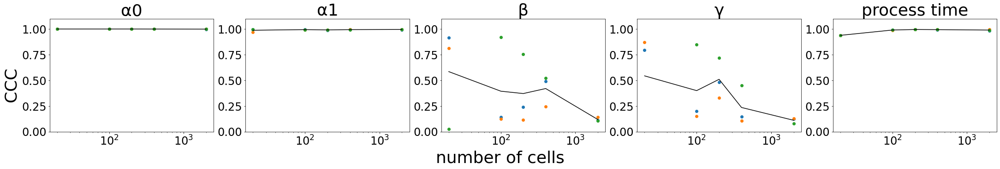

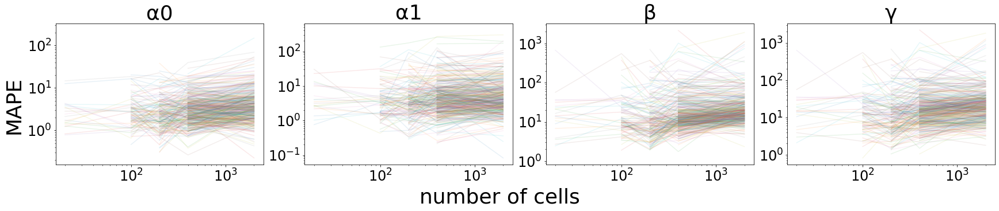

In [157]:
fig = plot_vary_p_results(results_dir+'vary_p_topo_1_1.pickle',ps=[20,100,200,400,2000],K=3)

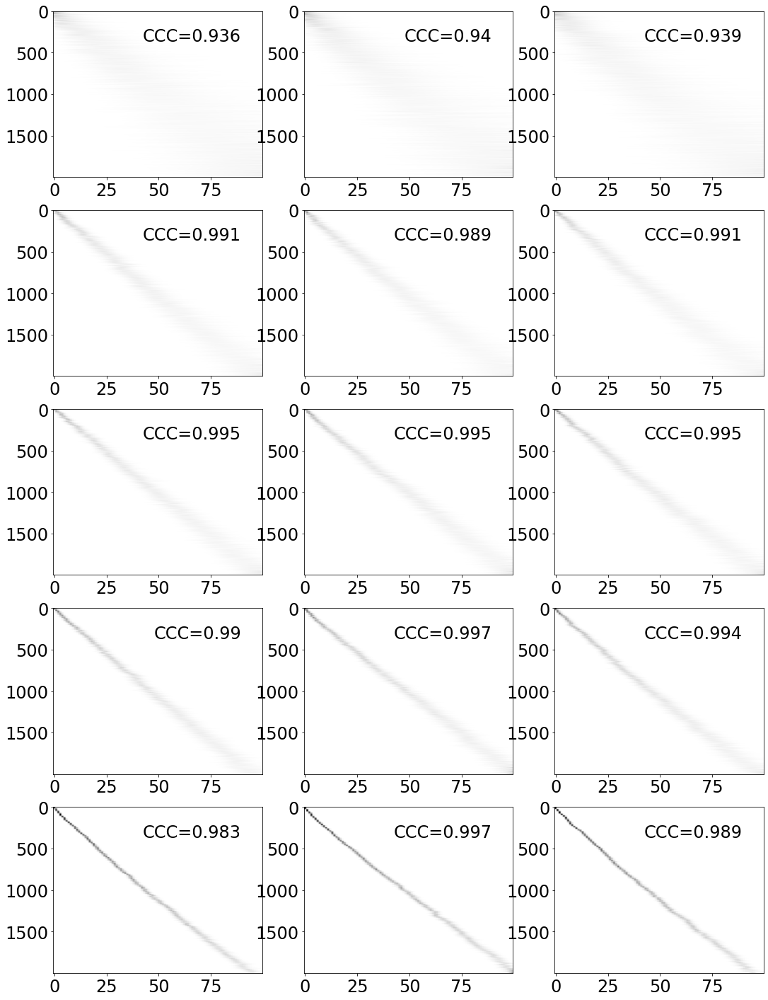

In [161]:
fig = plot_t_results(results_dir+'vary_p_topo_1_1.pickle',K=3)

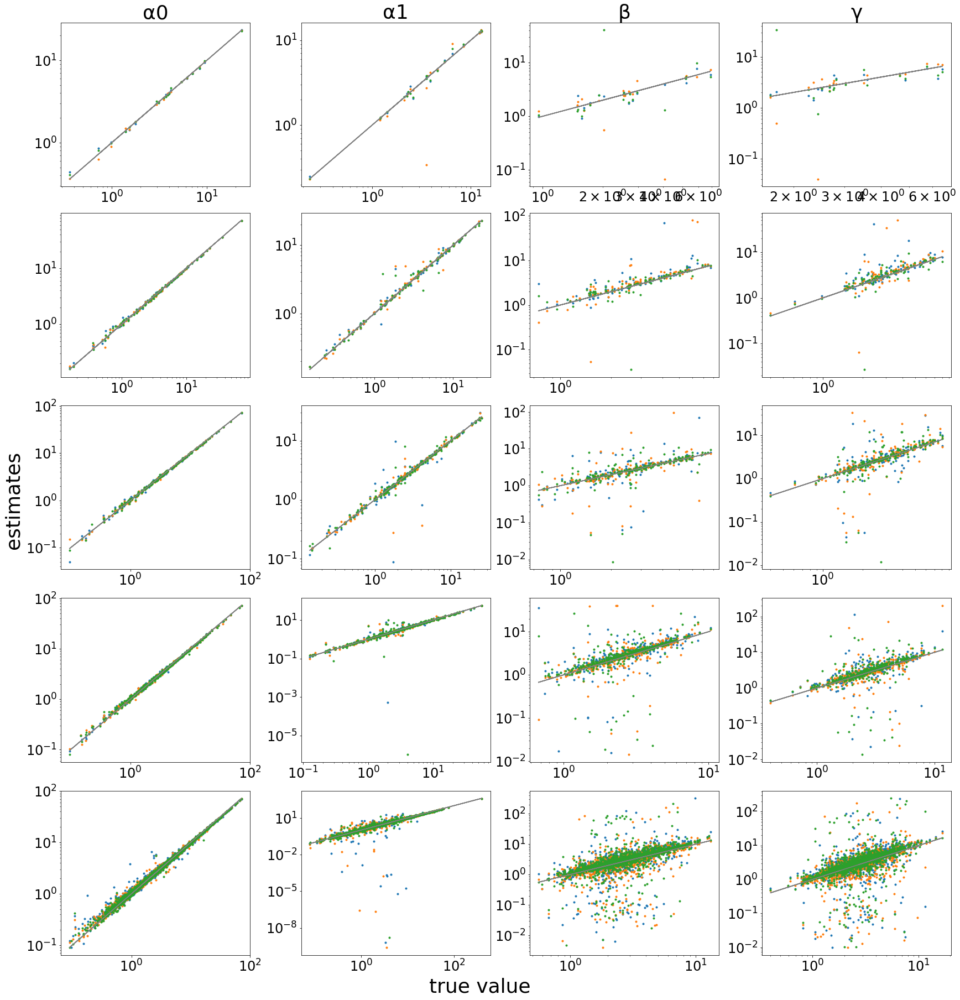

In [162]:
fig = plot_theta_results(results_dir+'vary_p_topo_1_1.pickle',K=3)

In [234]:
topo = np.array([[0,1,2]])
tau = (0,1,2)
results = fit_vary_p_fixed(topo, tau, n=1000, ps=[31,100,316], seed=1, K=10, n_init=10, m=100, epoch=100, cores=30)

with open(results_dir+'topo_2_vary_p_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

In [17]:
fig = plot_vary_results(results_dir+'topo_2_vary_p_1.pickle',xs=)

TypeError: plot_vary_results() missing 1 required positional argument: 'xs'

n_init =  10


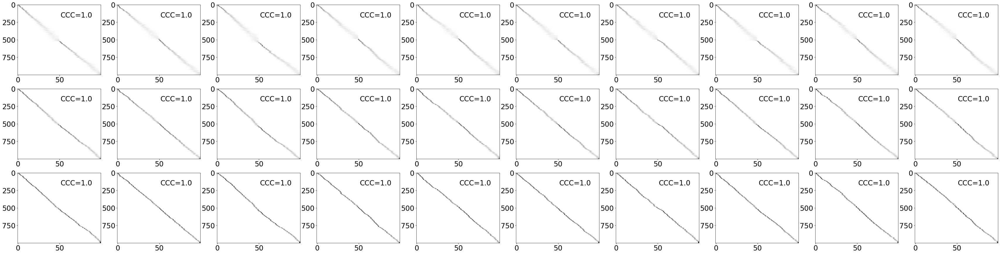

In [236]:
fig = plot_t_results(results_dir+'topo_2_vary_p_1.pickle')

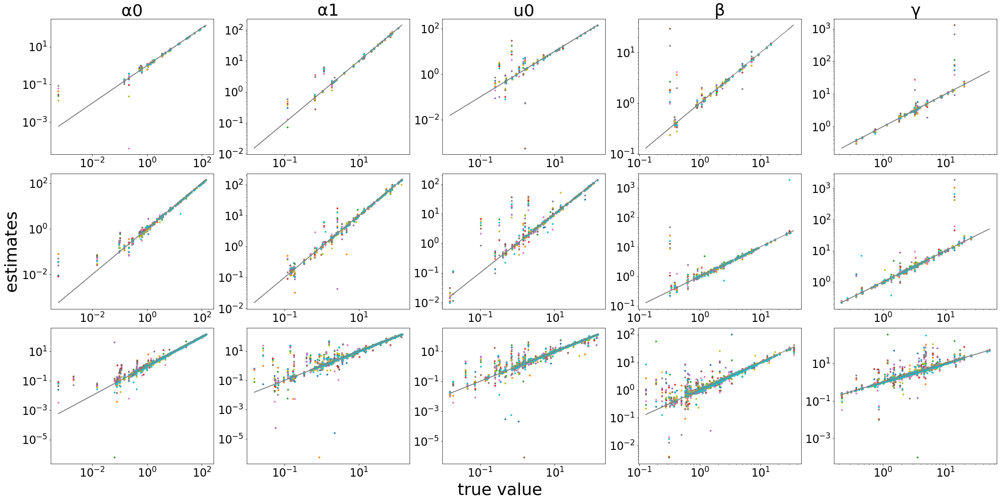

In [237]:
fig = plot_theta_results(results_dir+'topo_2_vary_p_1.pickle')

In [ ]:
topo = np.array([[0,1,2],[0,1,3]])
tau = (0,1,2)
print(time.ctime())
results = fit_vary_n_fixed(topo, tau, ns=[1000,3162,10000], p=100, seed=1, K=10, n_init=20, m=100, epoch=100, cores=10)
print(time.ctime())
with open(results_dir+'topo_2_vary_n_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

Mon Feb 13 14:42:46 2023


## Vary loga_mu: the mean of fitted genes should be larger than 0.1

In [166]:
def vary_loga_mu(topo, tau, n=2000, p=200, loga_mus=[0,1,2,3], t_samples=None, parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=100*n)
    
    theta=np.zeros((p,n_states+2))
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    
    Input_args = []
    for i,loga_mu in enumerate(loga_mus):    
        true_theta = theta.copy()
        true_theta[:,:n_states]=np.random.lognormal(loga_mu, loga_sd, size=(p,n_states))/true_theta[:,-2,None]

        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((true_theta[:,topo[l]], true_theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
                true_t = np.append(true_t,t)
        
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
                
            X = np.random.poisson(rd[:,None,None]*Y)         
            params={'r':rd}
            Input_args.append((X, topo, tau, true_t, true_theta, m, n_init, params))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

In [185]:
def plot_mean(picklefile,xs,K=3,logscale=True):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    assert len(results)//K == len(xs)
    
    fig, ax = plt.subplots(len(results)//K,K,figsize=(K*6,5*(len(results)//K)),constrained_layout=True)
    for i in range(len(results)):
        X = results[i].X  
        if logscale:
            ax[i//K,i%K].loglog(X[:,:,0].mean(axis=0),X[:,:,1].mean(axis=0),'.'); 
        else:
            ax[i//K,i%K].plot(X[:,:,0].mean(axis=0),X[:,:,1].mean(axis=0),'.'); 
    return

In [174]:
np.exp([-3,-2,-1,4,5])

array([4.97870684e-02, 1.35335283e-01, 3.67879441e-01, 5.45981500e+01,
       1.48413159e+02])

In [173]:
topo = np.array([[0,1,2]])
tau = (0,1,2)

results = vary_loga_mu(topo, tau, n=2000, p=200, loga_mus=[-3,-2,-1,0,1,2,3,4,5], t_samples=None,\
                       parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=30,\
                       loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25)

with open(results_dir+'vary_loga_mu_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

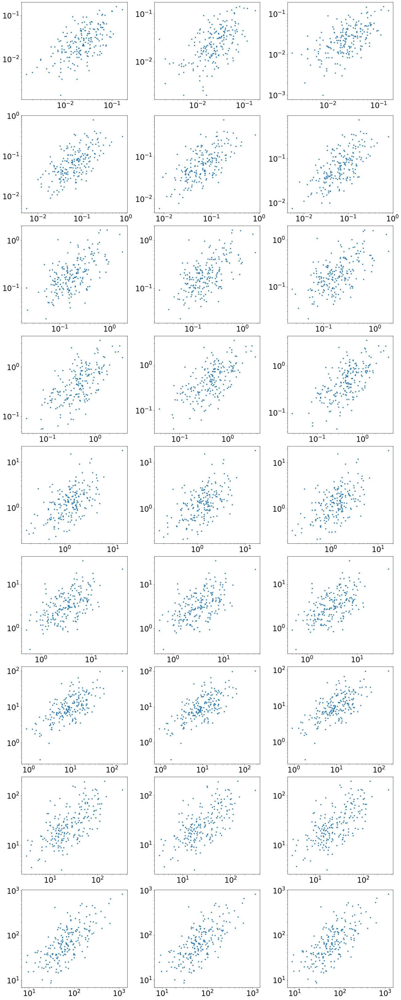

In [186]:
plot_mean(picklefile=results_dir+'vary_loga_mu_topo_1_1.pickle',xs=[-3,-2,-1,0,1,2,3,4,5],K=3)

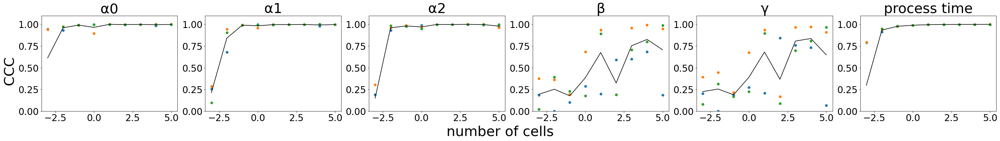

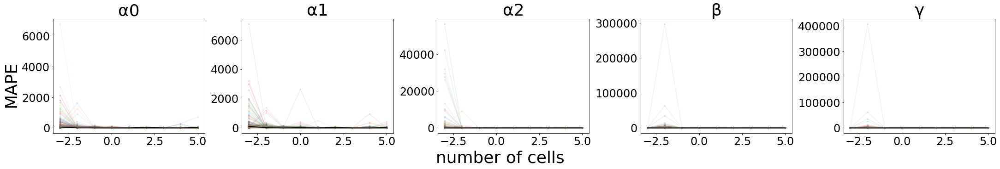

In [178]:
plot_vary_results(picklefile=results_dir+'vary_loga_mu_topo_2_1.pickle',xs=[-3,-2,-1,0,1,2,3,4,5],K=3,logscale=False)

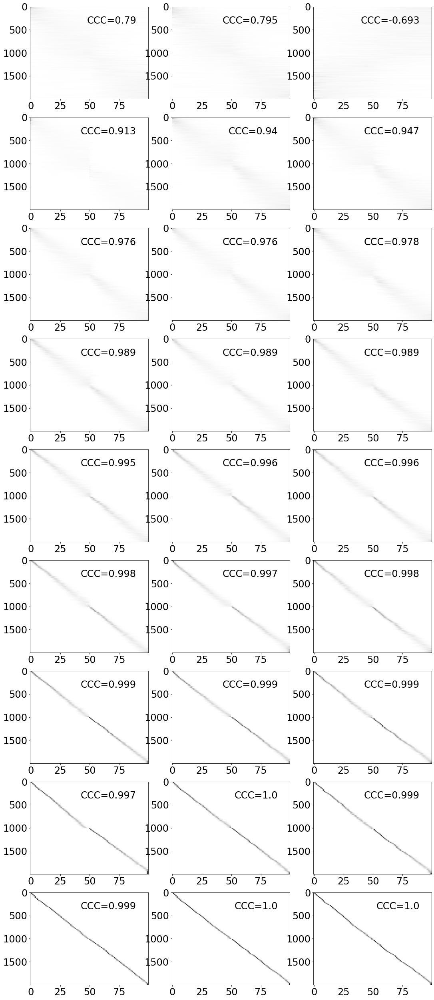

In [180]:
fig = plot_t_results(results_dir+'vary_loga_mu_topo_2_1.pickle',K=3)

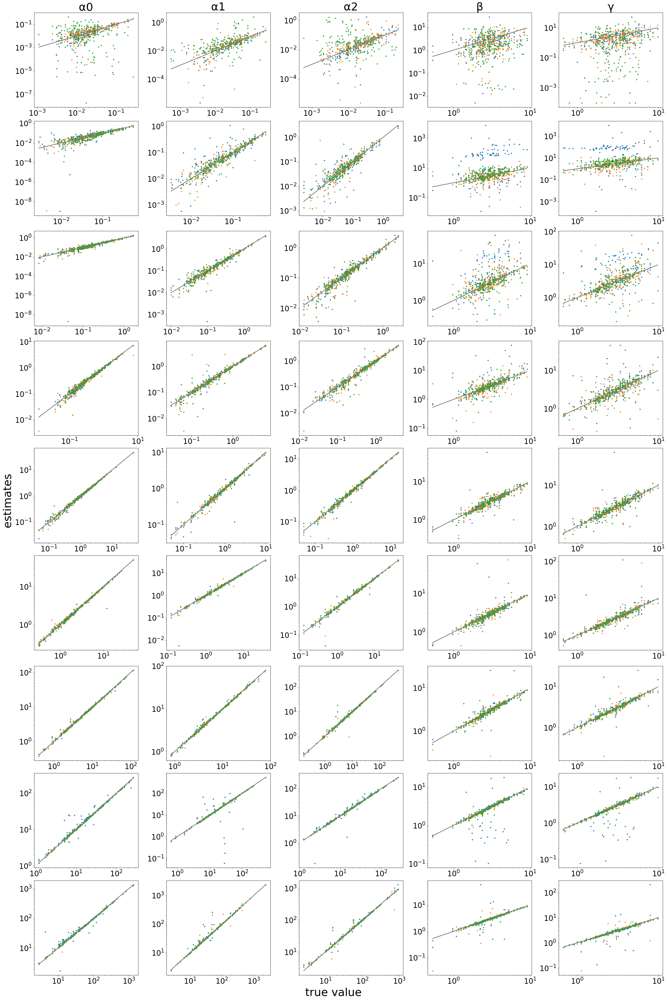

In [179]:
fig = plot_theta_results(results_dir+'vary_loga_mu_topo_2_1.pickle',K=3)

## Vary logb_mu

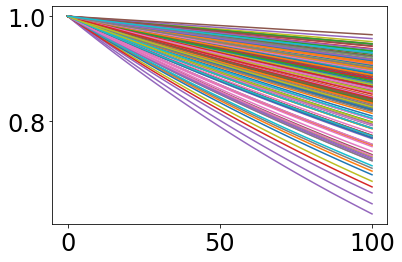

In [115]:
logb_mu = -2
logb_sd = 0.5
beta = np.random.lognormal(logb_mu,logb_sd,size=200).reshape((1,-1))
plt.plot(np.exp(-beta*np.linspace(0,1,101).reshape(-1,1)));

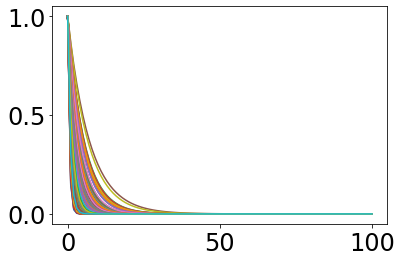

In [116]:
logb_mu = 4
logb_sd = 0.5
beta = np.random.lognormal(logb_mu,logb_sd,size=200).reshape((1,-1))
plt.plot(np.exp(-beta*np.linspace(0,1,101).reshape(-1,1)));

In [119]:
def vary_logb_mu(topo, tau, n=2000, p=200, logb_mus=[-2,-1,0,1,2,3,4], t_samples=None, parameter_seed=1, K=5, n_init=10, epoch=100, m=100, cores=35, loga_mu=2, loga_sd=1, logb_sd=0.5, rd_var=0.25):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=100*n)
    
    theta=np.zeros((p,n_states+2))
    theta[:,:n_states]=np.random.lognormal(loga_mu, loga_sd, size=(p,n_states))
    
    
    Input_args = []
    for i,logb_mu in enumerate(logb_mus):    
        true_theta = theta.copy()
        true_theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
        true_theta[:,:n_states]/=true_theta[:,-2,None]

        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((true_theta[:,topo[l]], true_theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
                true_t = np.append(true_t,t)
        
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
            X = np.random.poisson(rd[:,None,None]*Y)         
            params={'r':rd}
            Input_args.append((X, topo, tau, true_t, true_theta, m, n_init, params))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

In [120]:
topo = np.array([[0,1,2]])
tau = (0,1,2)

results = vary_logb_mu(topo, tau, n=2000, p=200, logb_mus=[-2,-1,0,1,2,3,4], t_samples=None,\
                       parameter_seed=1, K=5, n_init=10, epoch=100, m=100, cores=35,\
                       loga_mu=2, loga_sd=1, logb_sd=0.5, rd_var=0.25)

with open(results_dir+'vary_logb_mu_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

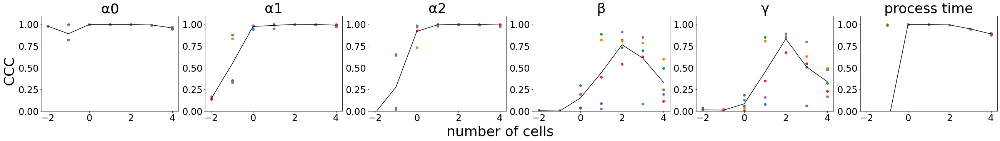

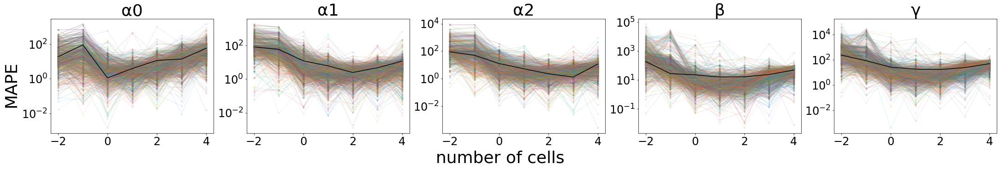

In [362]:
picklefile=results_dir+'vary_logb_mu_topo_1_1.pickle'

plot_vary_results(picklefile,xs=[-2,-1,0,1,2,3,4],K=5,logscale=False)

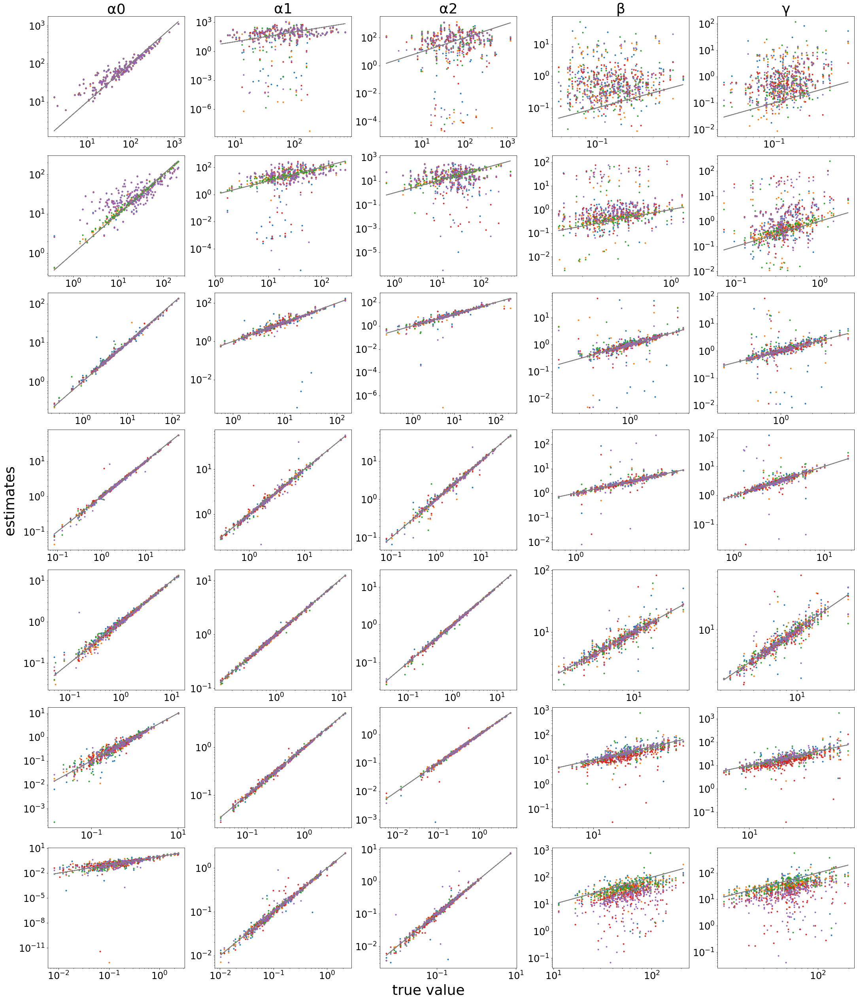

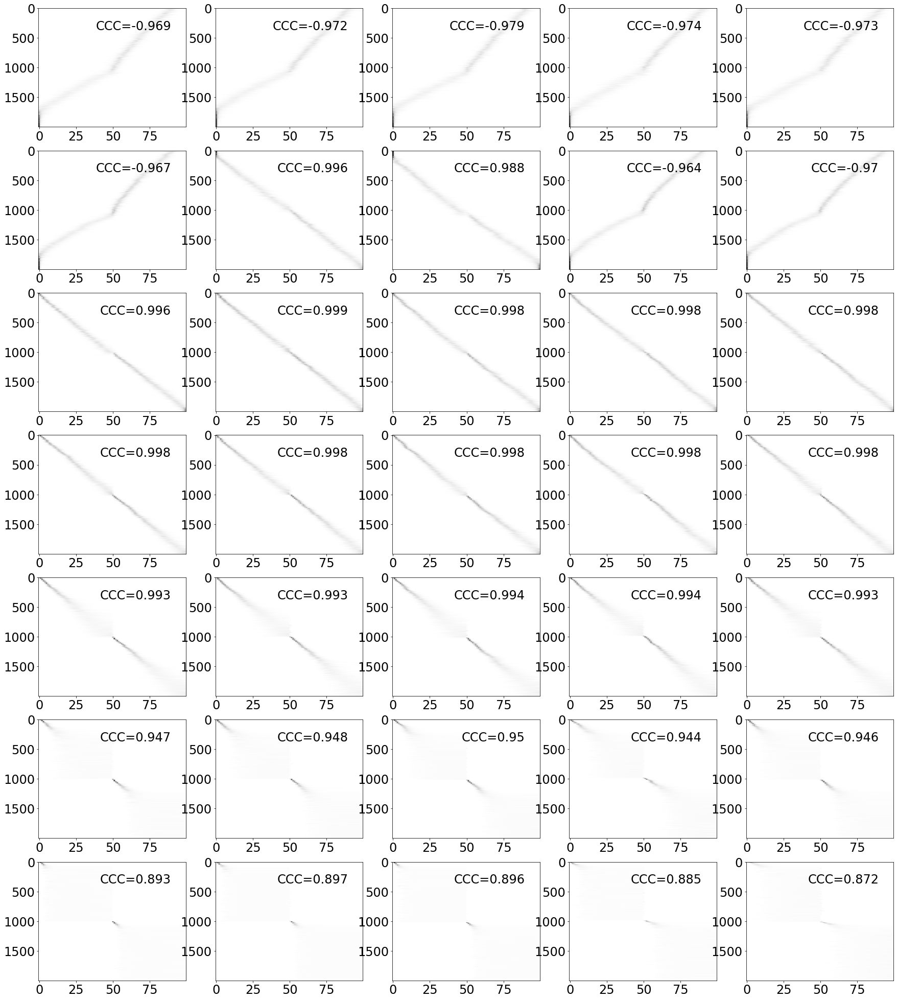

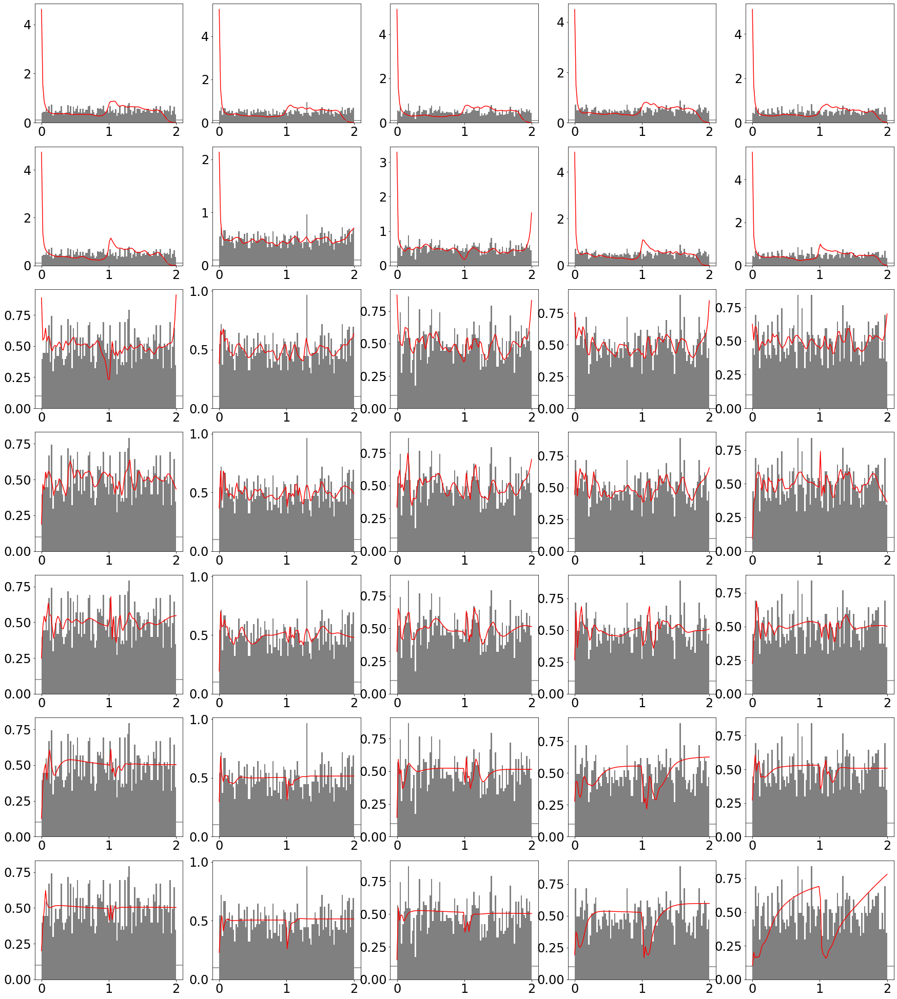

In [363]:
fig = plot_theta_results(picklefile,K=5)
fig = plot_t_results(picklefile,K=5)

## Vary read depth variance

In [84]:
def vary_r(topo, tau, n=2000, p=200, t_samples=None, rd_vars=[0,0.1,0.25,0.5,1], params_r="True", parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=100*n)
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i,rd_var in enumerate(rd_vars):             
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
                true_t = np.append(true_t,t)
        
            if rd_var != 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L) # s.t. mean = 1 and var = rd_var
                rd = read_depth/read_depth.mean()
                X = np.random.poisson(rd[:,None,None]*Y)
            else:
                rd = np.ones(n*L)
                X = np.random.poisson(Y)
            
            if params_r == "True":
                params={'r':rd}
            elif params_r == "Fit":
                params = {"r":X.mean((1,2))/X.mean()}
            elif params_r == "None":
                params={}
            else:
                raise ValueError('Check params_r')
                
            Input_args.append((X, topo, tau, true_t, theta, m, n_init, params))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

In [166]:
topo = np.array([[0,1,2]])
tau = (0,1,2)

results = vary_r(topo, tau, params_r == "True")
with open(results_dir+'vary_rt_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

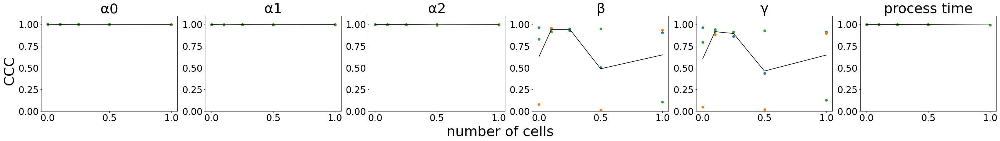

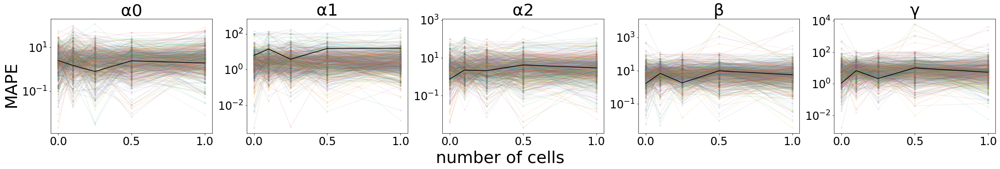

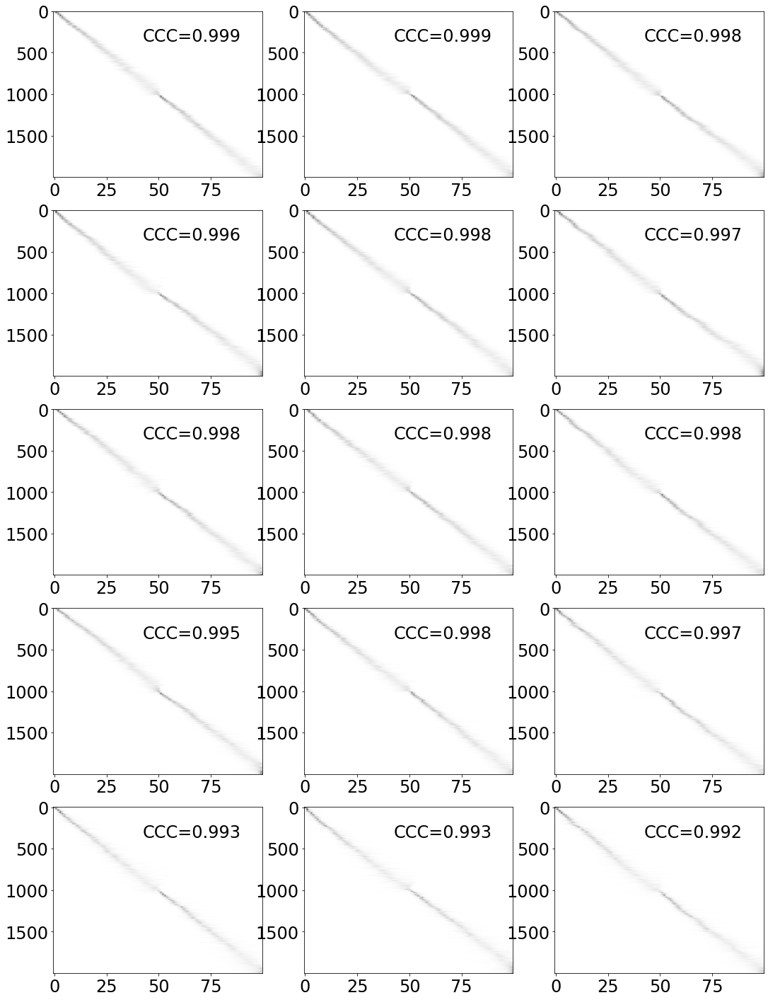

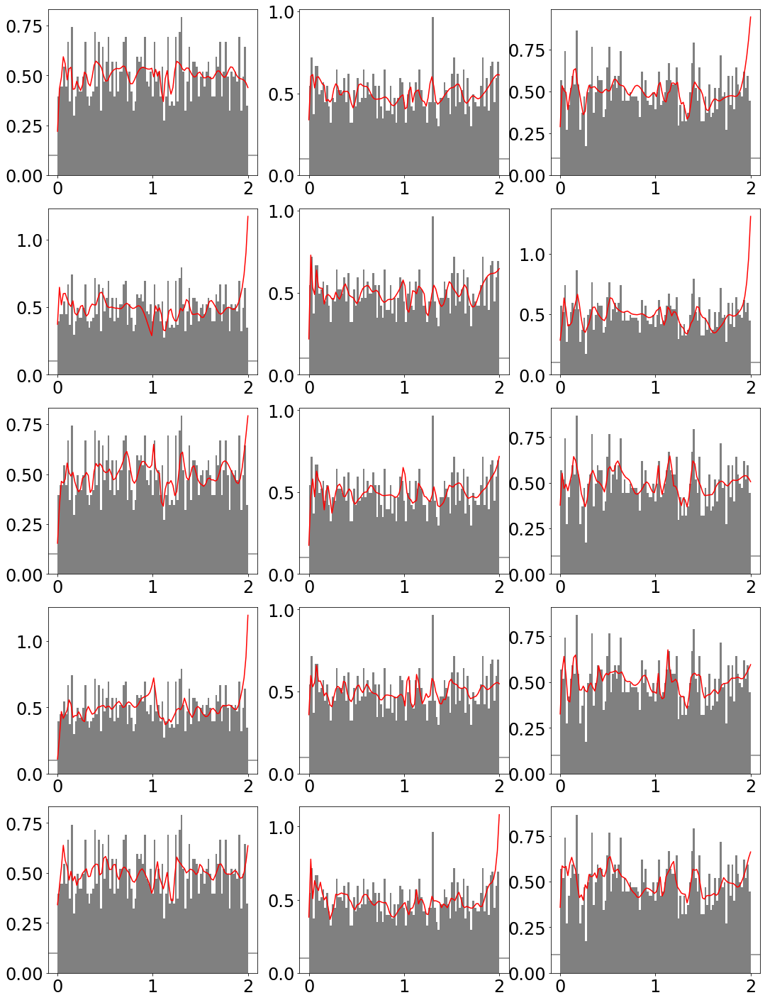

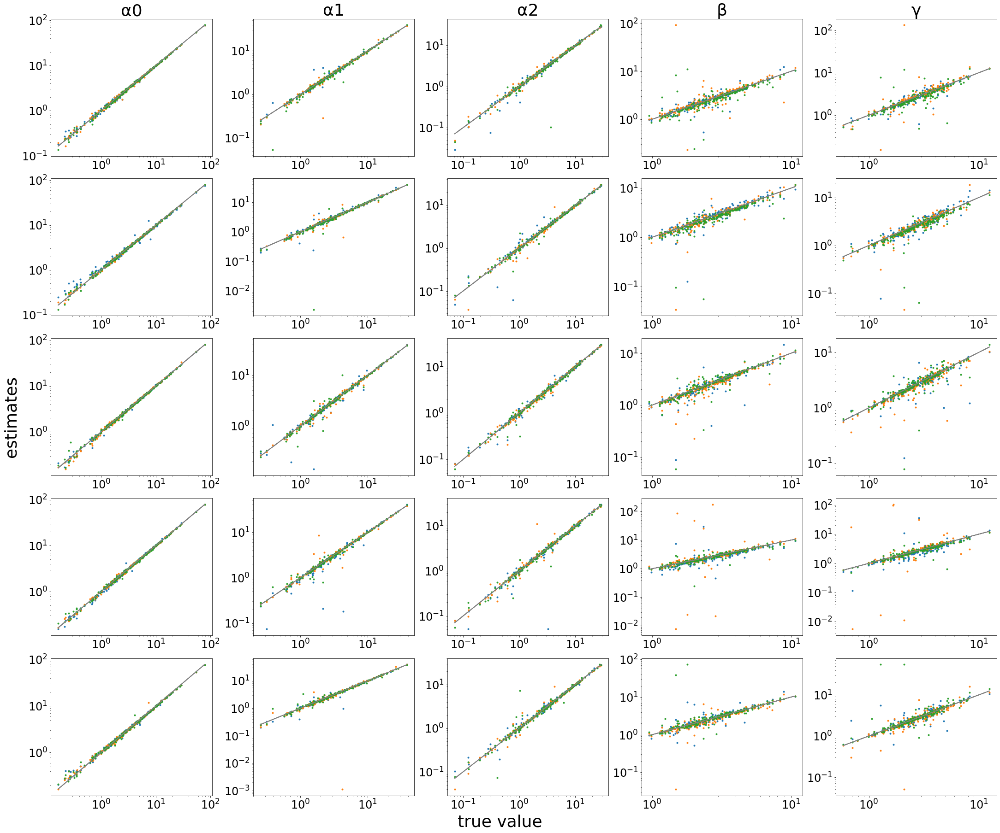

In [365]:
picklefile=results_dir+'vary_rt_topo_1_1.pickle'

plot_vary_results(picklefile,xs=[0,0.1,0.25,0.5,1],K=3,logscale=False)
fig = plot_t_results(picklefile,K=3)
fig = plot_theta_results(picklefile,K=3)

In [176]:
topo = np.array([[0,1,2]])
tau = (0,1,2)

results = vary_r(topo, tau, params_r == "None":)
with open(results_dir+'vary_rn_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

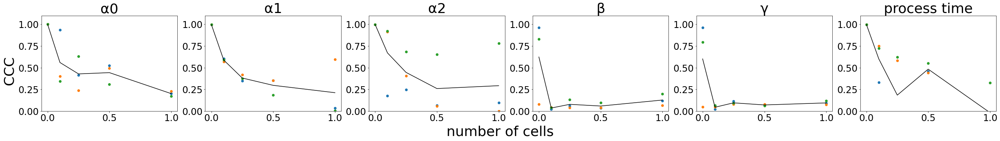

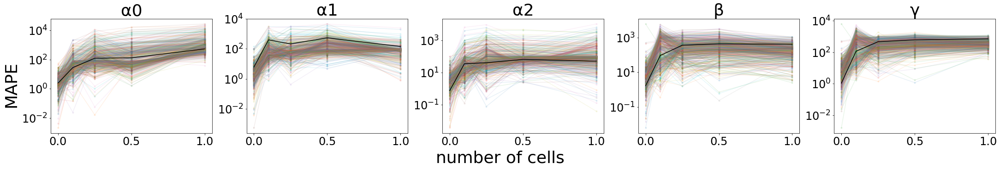

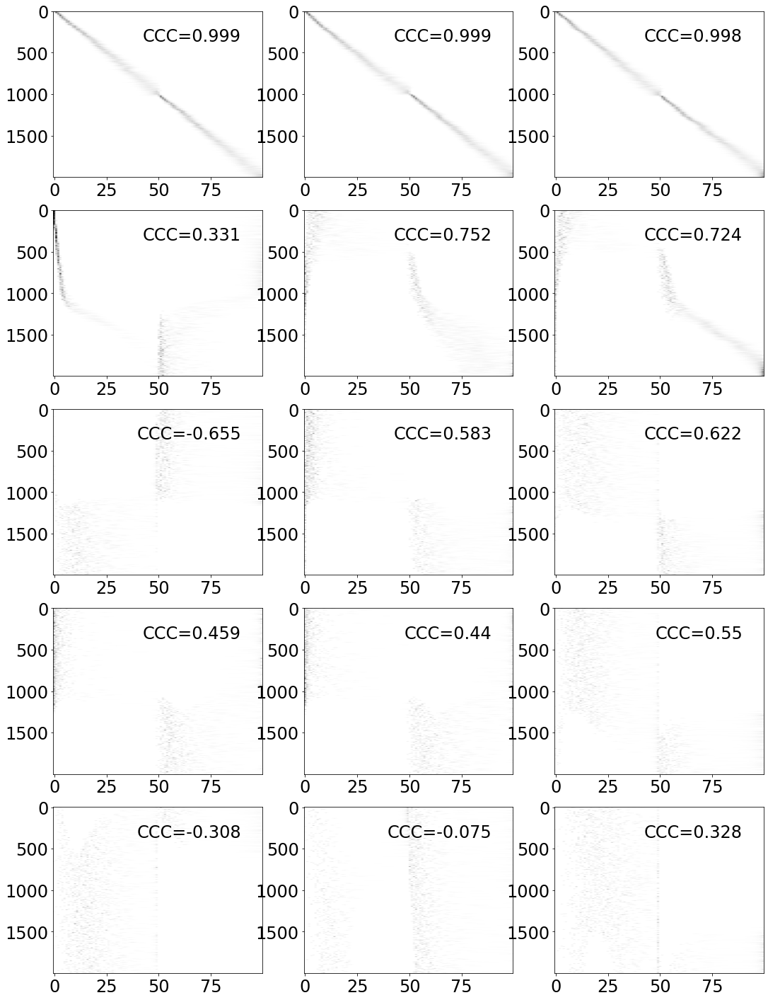

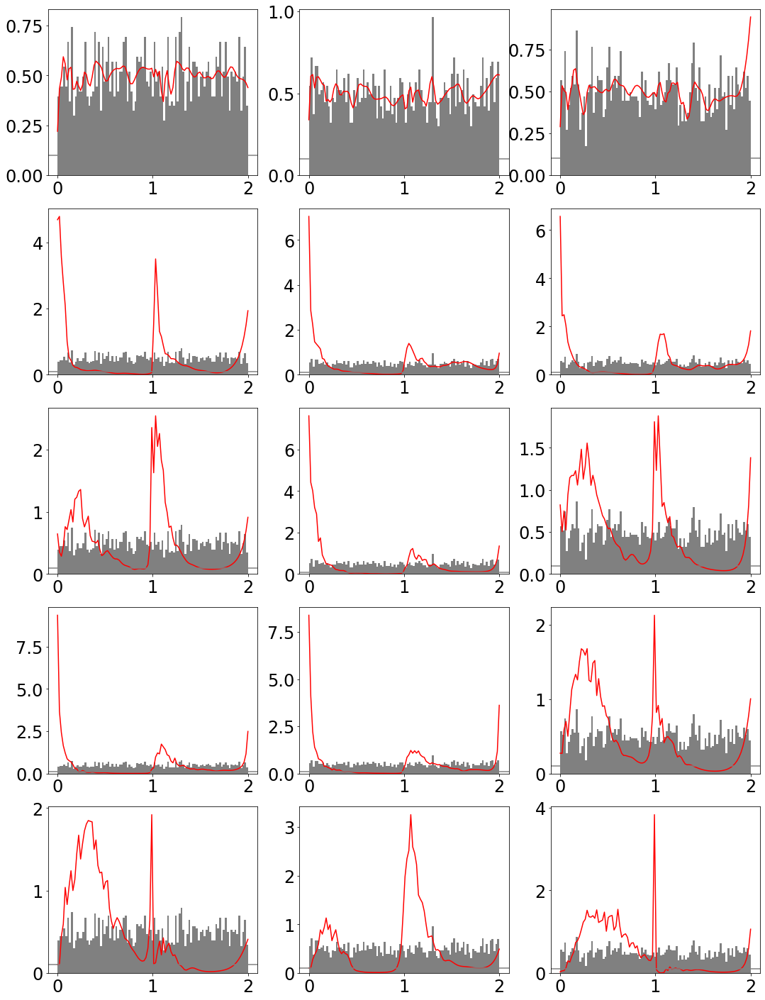

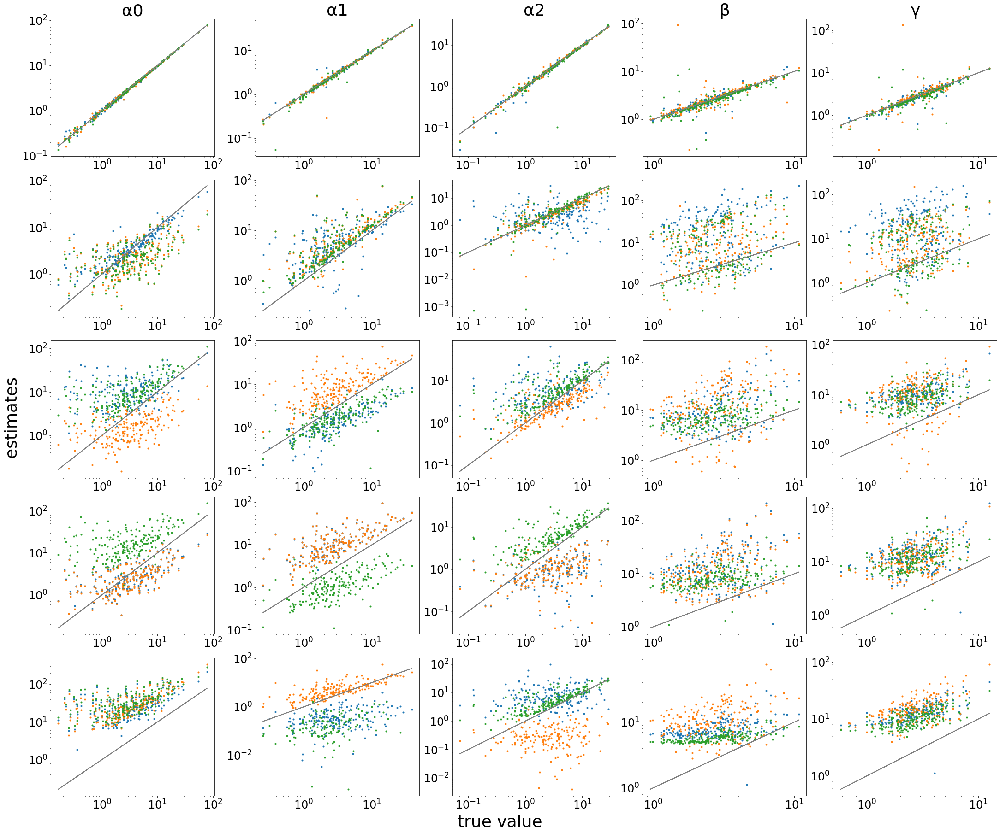

In [366]:
picklefile = results_dir+'vary_rn_topo_1_1.pickle'

plot_vary_results(picklefile=picklefile,xs=[0,0.1,0.25,0.5,1],K=3,logscale=False)
fig = plot_t_results(picklefile,K=3)
fig = plot_theta_results(picklefile,K=3)

In [88]:
topo = np.array([[0,1,2]])
tau = (0,1,2)

results = vary_r(topo, tau, n=2000, p=200, t_samples=None, rd_vars=[0,0.1,0.25,0.5], params_r="Fit",\
                 parameter_seed=1, K=10, n_init=10, epoch=100, m=100, cores=40,\
                 loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5)

with open(results_dir+'vary_rf_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

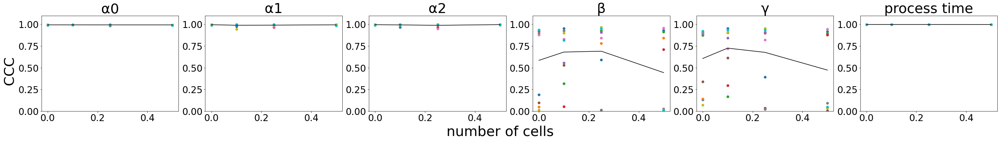

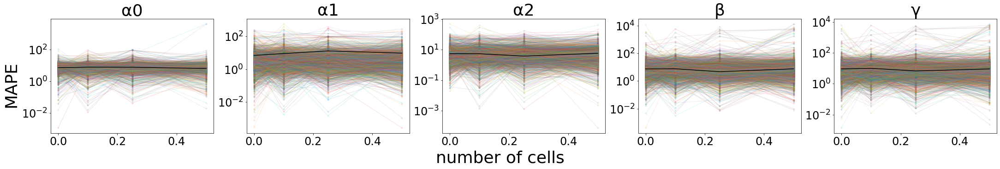

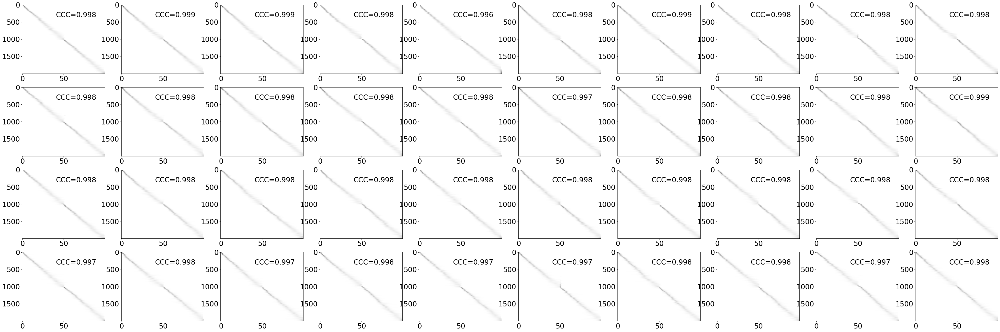

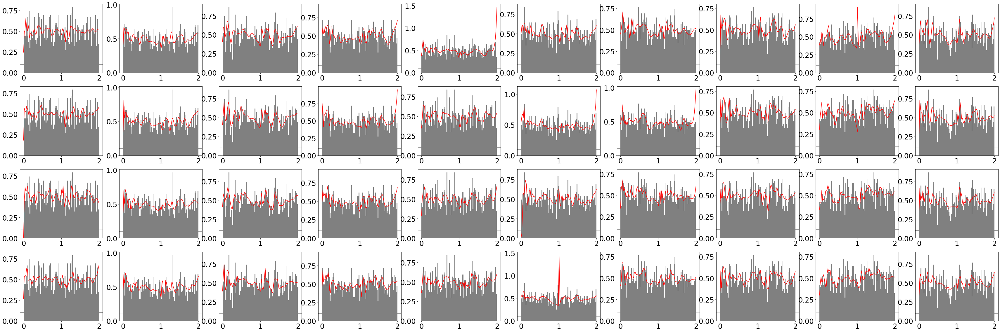

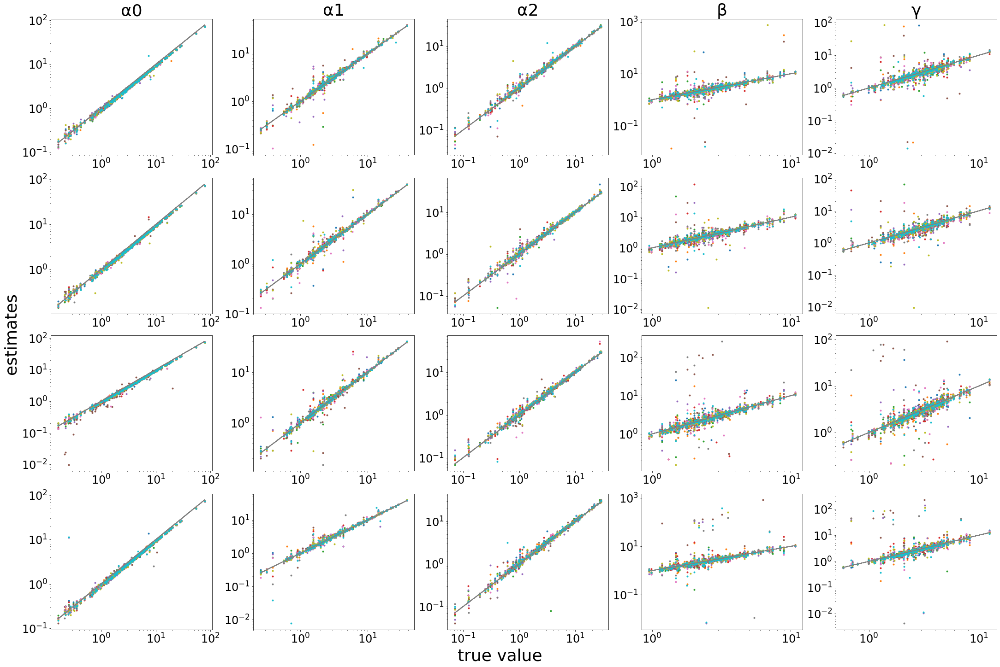

In [367]:
picklefile = results_dir+'vary_rf_topo_1_1.pickle'

plot_vary_results(picklefile=picklefile,xs=[0,0.1,0.25,0.5],K=10,logscale=False)
fig = plot_t_results(picklefile,K=10)
fig = plot_theta_results(picklefile,K=10)

## Vary tau

In [ ]:
from multiprocessing import Pool

def vary_tau(topo, tau, n=2000, p=200, t_samples=None, true_taus=[[0,0.5,2],[0,0.75,2],[0,1,2],[0,1.25,2],[0,1.5,2]], parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=100*n)
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i,true_tau in enumerate(true_taus):             
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,true_tau) # m*p*2
                true_t = np.append(true_t,t)
                
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
            X = np.random.poisson(rd[:,None,None]*Z)         
            params={'r':rd}
            Input_args.append((X, topo, tau, true_t, true_theta, m, n_init, params, True))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_tau_wrapper, Input_args, chunksize=1)
    
    return results

In [ ]:
topo = np.array([[0,1,2]])
tau = (0,1.0,2.0)

results = vary_tau(topo, tau)
with open(results_dir+'vary_tau_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

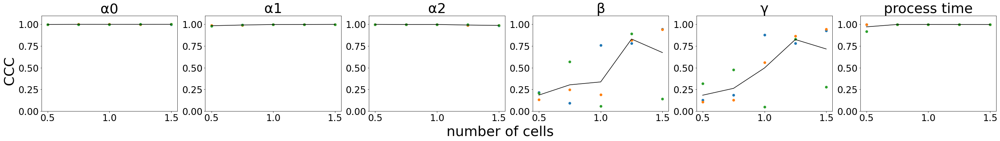

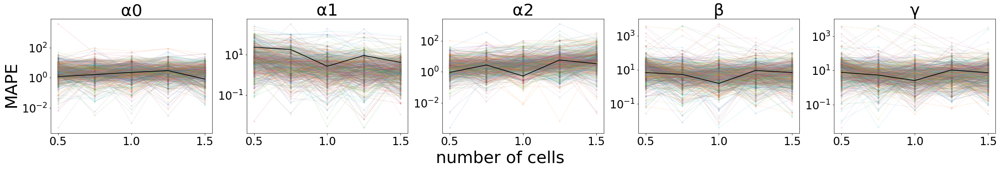

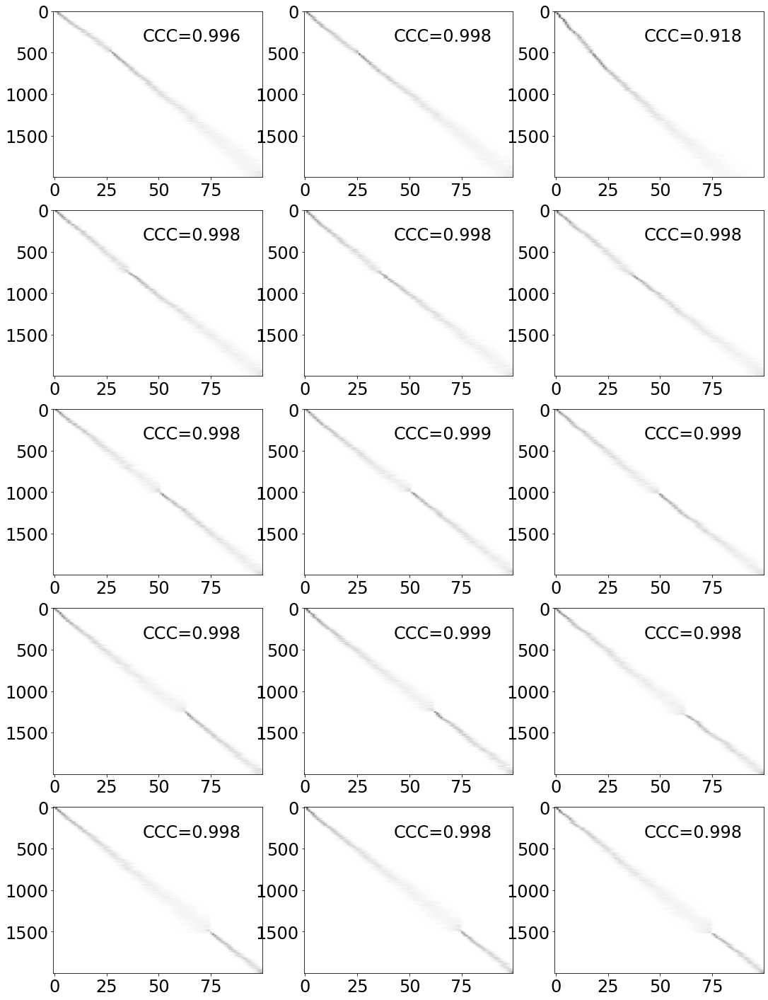

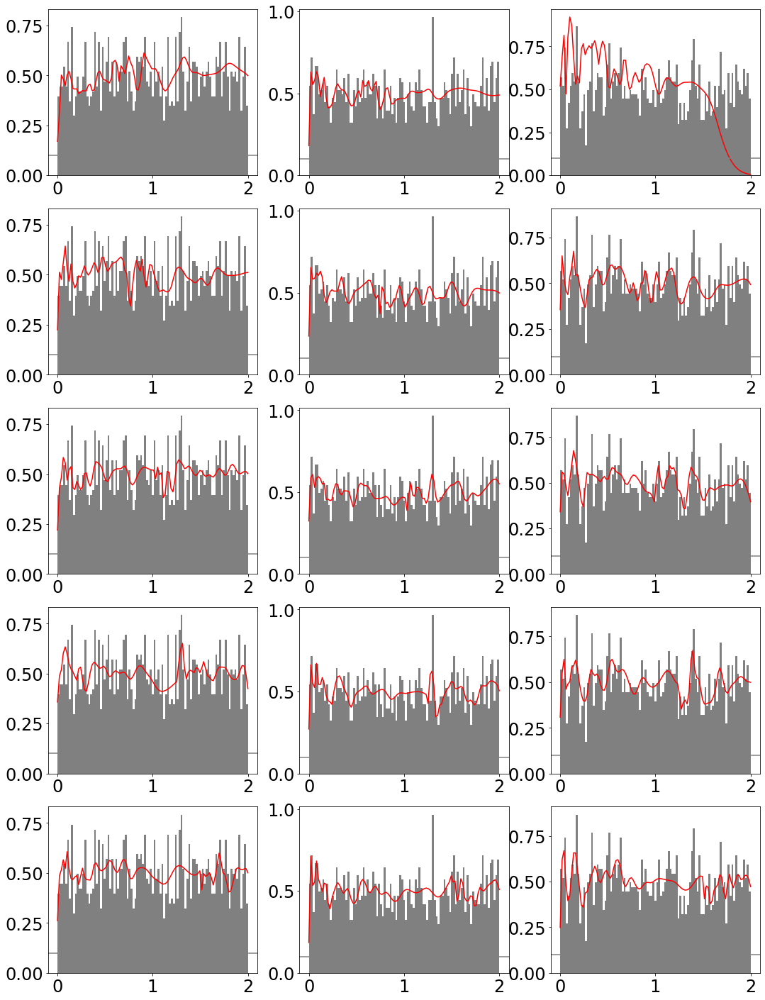

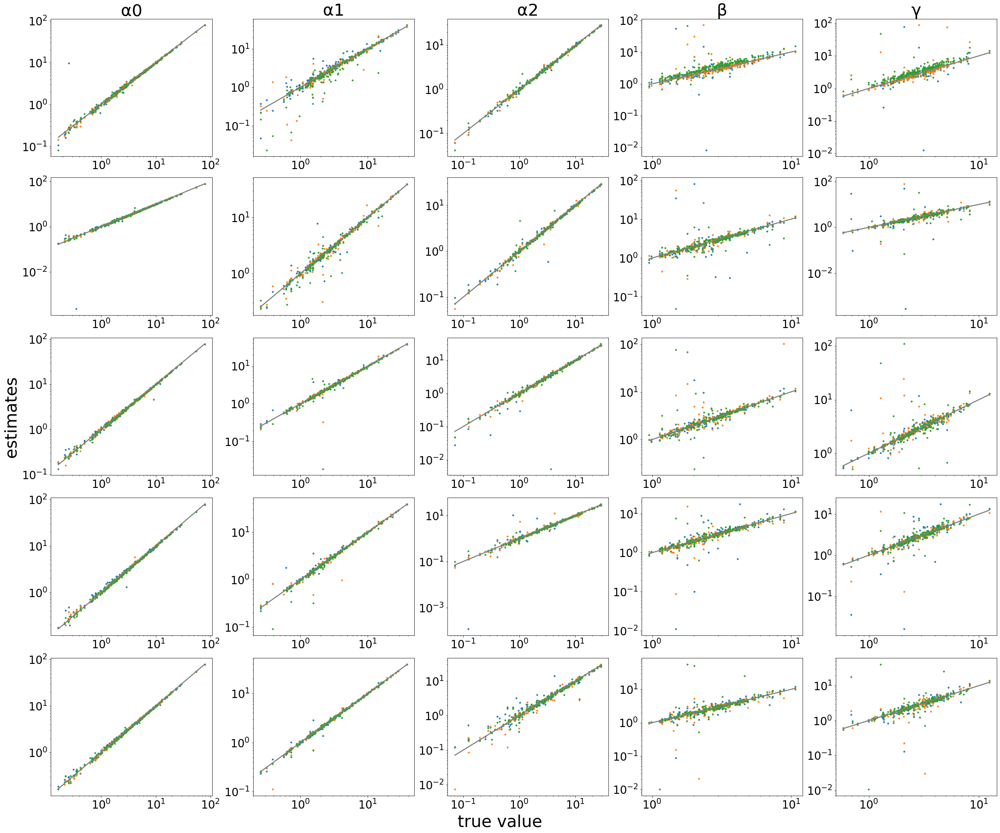

In [368]:
picklefile = results_dir+'vary_tau_topo_1_1.pickle'
plot_vary_results(picklefile=picklefile,xs=[0.5,0.75,1,1.25,1.5],K=3,logscale=False)
fig = plot_t_results(picklefile,K=3)
fig = plot_theta_results(picklefile,K=3)

## Add and vary sequencing noise

In [105]:
def vary_Er(topo, tau, true_tau=None, Ers=[0,0.1,0.5,1], n=2000, p=200, t_samples=None, parameter_seed=0, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if t_samples is None:
        t_samples=np.random.uniform(true_tau[0],true_tau[-1],size=10*n)
    if true_tau is None:
        true_tau = tau.copy()
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i,Er in enumerate(Ers):             
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,true_tau) # m*p*2
                true_t = np.append(true_t,t)
                
                
            if Er > 0:
                Z = Er*np.random.poisson(Y/Er)
            else:
                Z = Y.copy()
            
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
                
            X = np.random.poisson(rd[:,None,None]*Z)  
            
            params = {"r":X.mean((1,2))/X.mean()}
            Input_args.append((X, topo, tau, true_t, theta, m, n_init, params, False))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

In [106]:
topo = np.array([[0,1,2]])
tau = (0,1,2)
results = vary_Er(topo, tau, true_tau=(0,1,2), Ers=[0,0.1,0.5,1], n=2000, p=200, t_samples=None,\
                  parameter_seed=1, K=10, n_init=10, epoch=100, m=100, cores=40,\
                  loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25)

with open(results_dir+'vary_Er_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

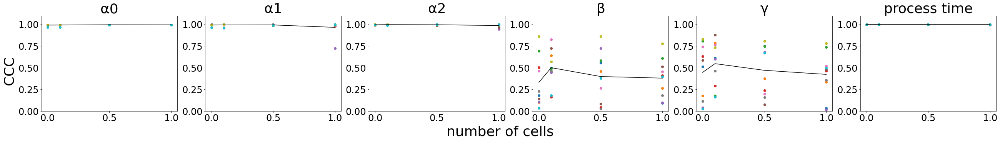

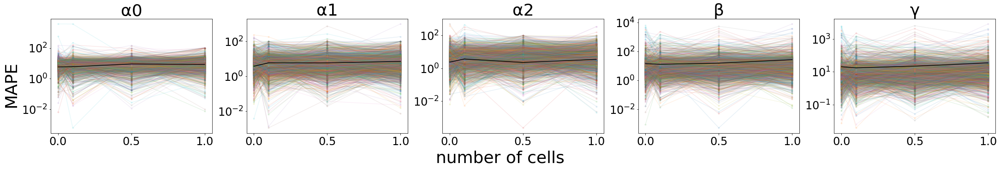

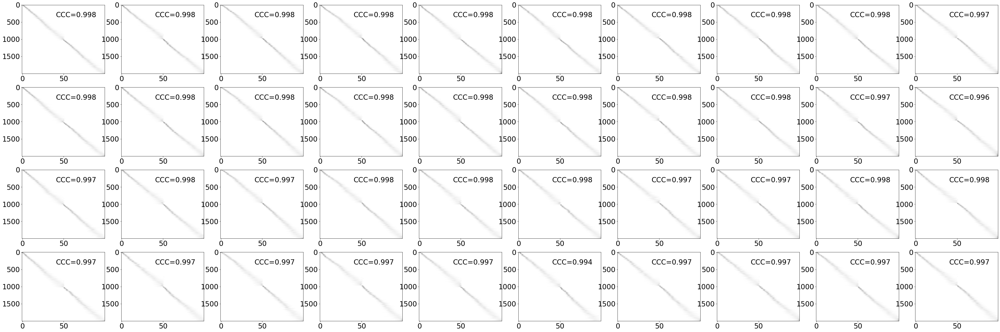

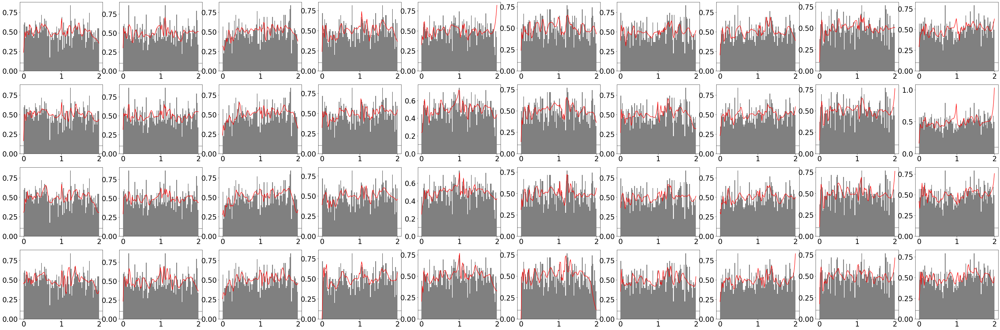

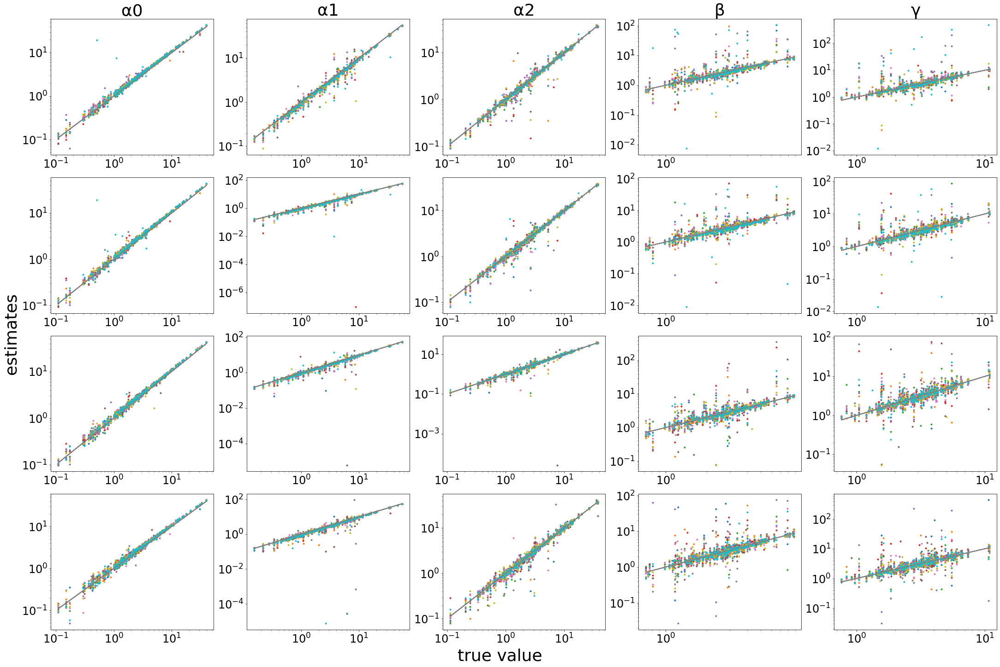

In [369]:
picklefile = results_dir+'vary_Er_topo_1_1.pickle'
plot_vary_results(picklefile=picklefile,xs=[0,0.1,0.5,1],K=10,logscale=False)
fig = plot_t_results(picklefile,K=10)
fig = plot_theta_results(picklefile,K=10)

## Add and vary U/S bias

In [189]:
def vary_Ub(topo, tau, true_tau=None, logu_mus=[0,-1,-2,-3], logu_sd=0.5,  n=2000, p=200, t_samples=None, parameter_seed=0, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if true_tau is None:
        true_tau = tau
    if t_samples is None:
        t_samples=np.random.uniform(true_tau[0],true_tau[-1],size=10*n)
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i,logu_mu in enumerate(logu_mus): 
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,true_tau) # m*p*2
                true_t = np.append(true_t,t)
                
            if logu_sd > 0:
                Ubias = np.random.lognormal(logu_mu,logu_sd,p)
            else:
                Ubias = np.ones(p)*np.exp(logu_mu)
            Y[:,:,0] *= Ubias[None,:]
                
            if Er > 0:
                Z = Er*np.random.poisson(Y/Er)
            else:
                Z = Y.copy()
            
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
            X = np.random.poisson(rd[:,None,None]*Z)  
            
            params = {"r":X.mean((1,2))/X.mean(),'Ubias':Ubias}
            Input_args.append((X, topo, tau, true_t, theta, m, n_init, params))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

In [209]:
topo = np.array([[0,1,2]])
tau = (0,1,2)
results = vary_Ub(topo, tau, logu_mus=[1,0,-1,-2,-3,-4,-5], logu_sd=0.5,\
                  true_tau=None, n=2000, p=200, t_samples=None,\
                  parameter_seed=0, K=3, n_init=10, epoch=100, m=100, cores=18,\
                  loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25)

with open(results_dir+'vary_Ub_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

In [ ]:
topo = np.array([[0,1,2],[0,1,3]])
tau = (0,1,2)
results = vary_Ub(topo, tau, logu_mus=[1,0,-1,-2,-3,-4,-5], logu_sd=0.5,\
                  true_tau=(0,0.8,2), n=2000, p=200, t_samples=None,\
                  parameter_seed=0, K=3, n_init=10, epoch=100, m=100, cores=18,\
                  loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25)

with open(results_dir+'vary_Ub_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

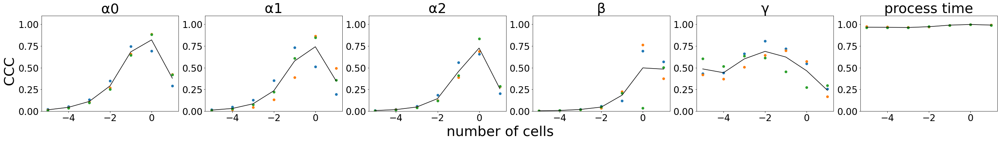

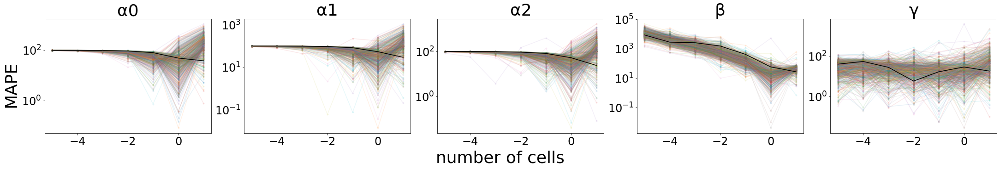

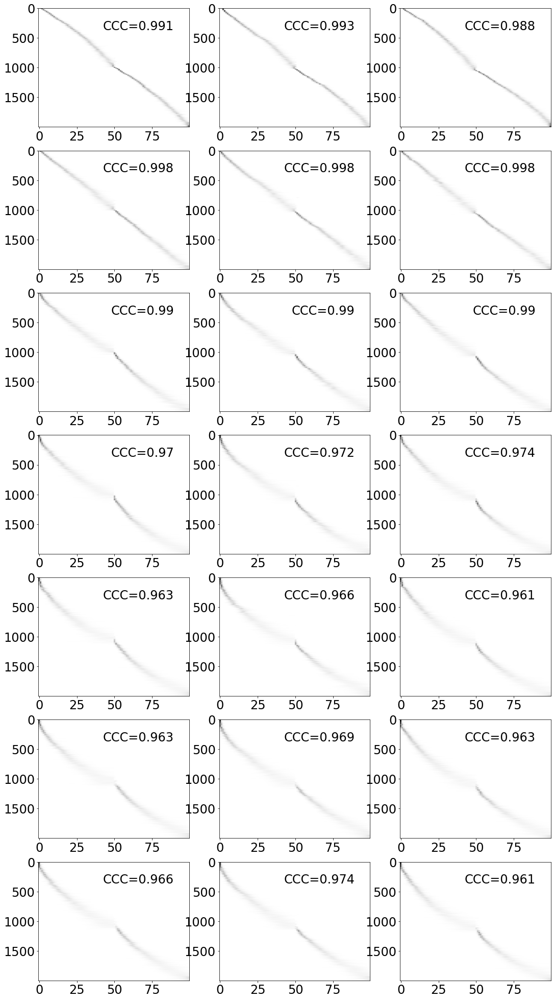

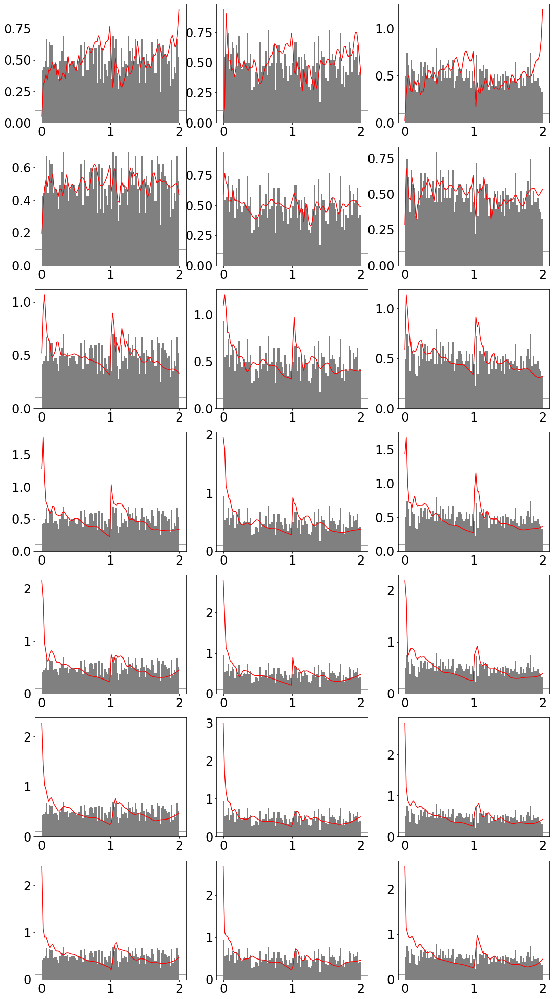

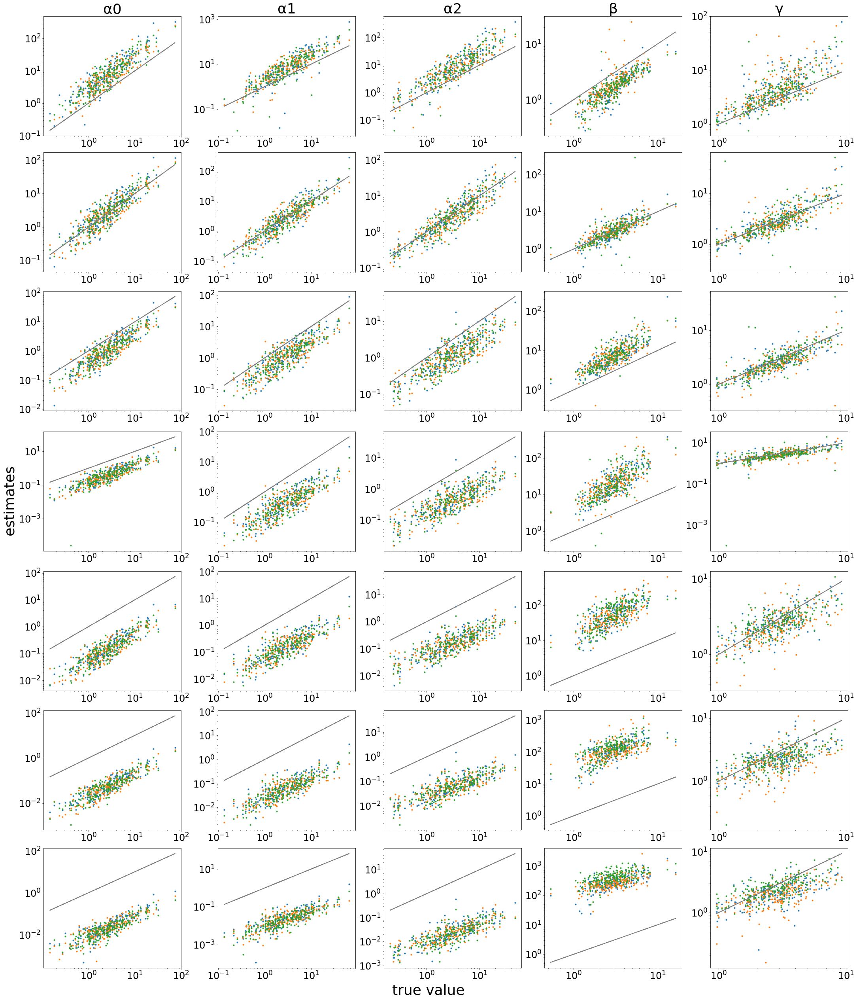

In [370]:
picklefile = results_dir+'vary_Ub_topo_1_1.pickle'

plot_vary_results(picklefile=picklefile,xs=[1,0,-1,-2,-3,-4,-5],K=3,logscale=False)
fig = plot_t_results(picklefile,K=3)
fig = plot_theta_results(picklefile,K=3)

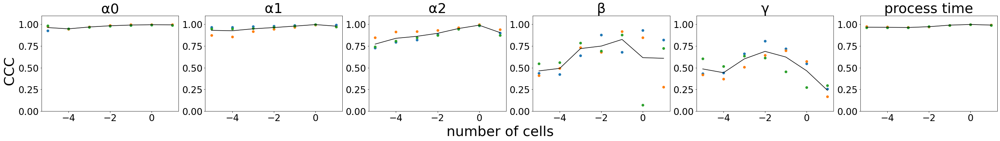

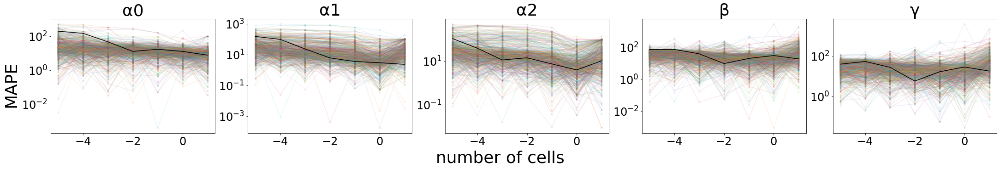

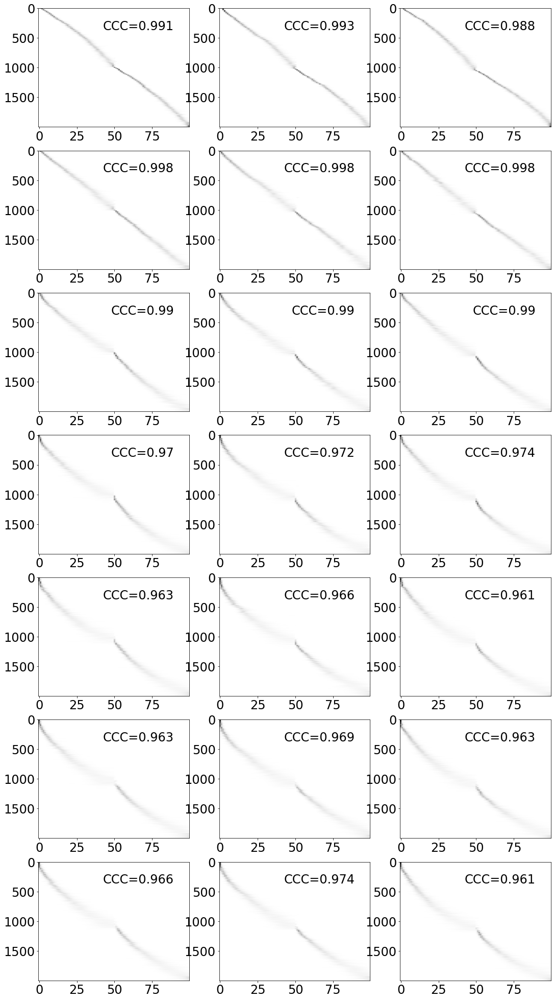

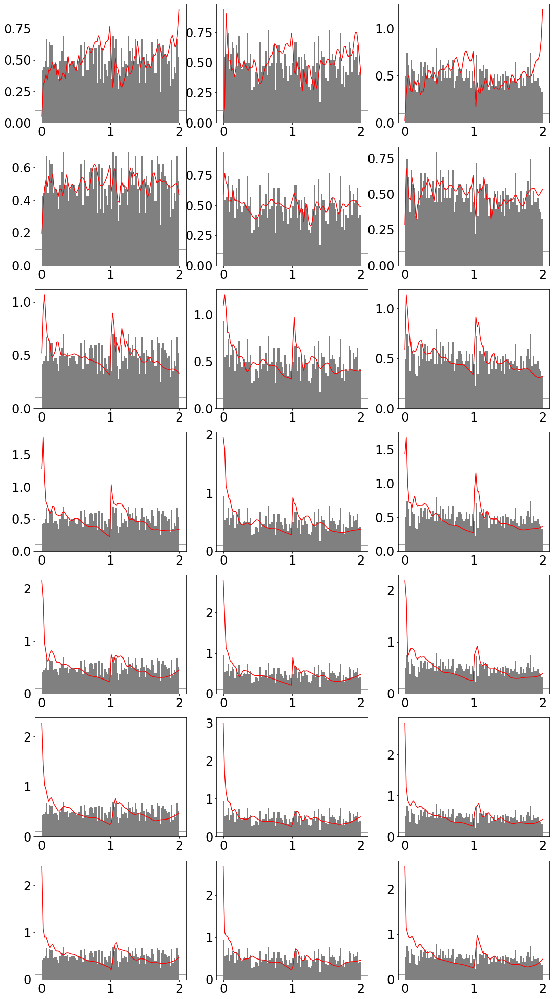

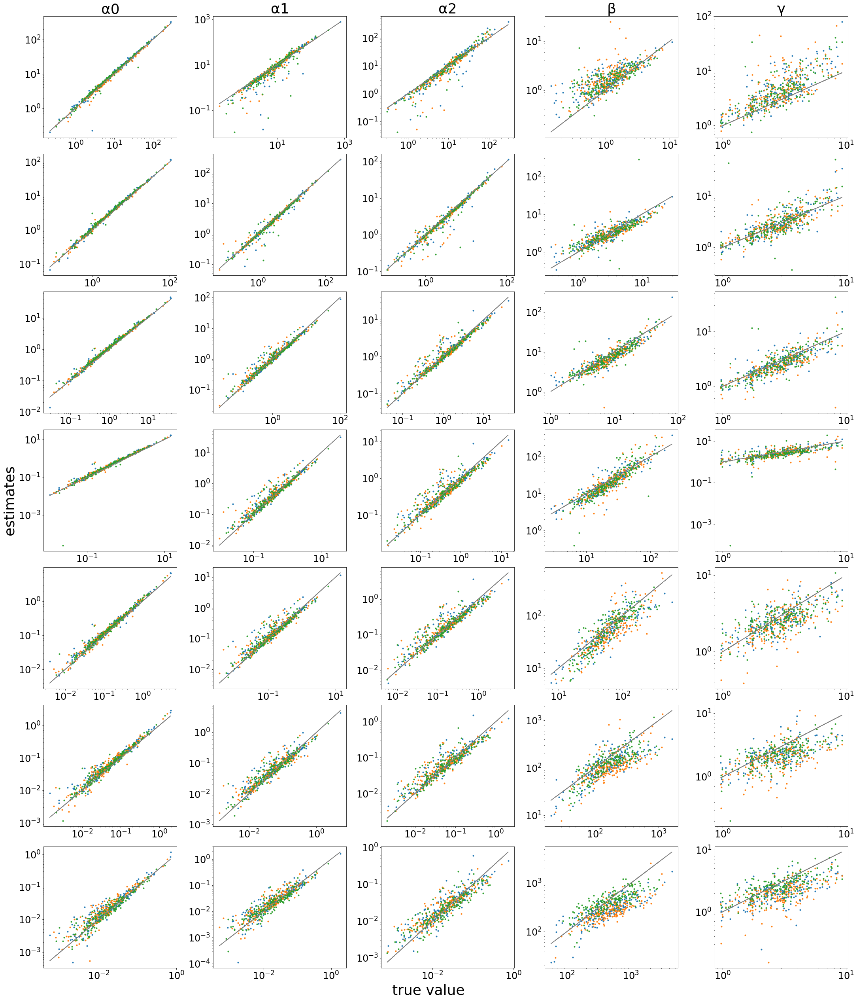

In [371]:
picklefile = results_dir+'vary_Ub_topo_1_1.pickle'

plot_vary_results(picklefile=picklefile,xs=[1,0,-1,-2,-3,-4,-5],K=3,logscale=False,Ub_correct=True)
fig = plot_t_results(picklefile,K=3)
fig = plot_theta_results(picklefile,K=3,Ub_correct=True)

# Sampling distribution

## 0 + uniform

In [235]:
def vary_t_perc(topo, tau, true_tau=None, t_percs=[0,0.1,0.5,0.9,0.99], n=2000, p=200, parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25, logu_mu=0, logu_sd=0):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if true_tau is None:
        true_tau = tau
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i, t_perc in enumerate(t_percs): 
        t_samples=np.random.uniform(true_tau[0],true_tau[-1],size=10*n)
        t_samples[:int(10*n*t_perc)] = tau[0]
        for k in range(K):
            np.random.seed(k)
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,true_tau) # m*p*2
                true_t = np.append(true_t,t)
                
            if logu_sd > 0:
                Ubias = np.random.lognormal(logu_mu,logu_sd,p)
            else:
                Ubias = np.ones(p)*np.exp(logu_mu)
            Y[:,:,0] *= Ubias[None,:]
                
            if Er > 0:
                Z = Er*np.random.poisson(Y/Er)
            else:
                Z = Y.copy()
            
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
            X = np.random.poisson(rd[:,None,None]*Z)  
            
            params = {"r":X.mean((1,2))/X.mean(),'Ubias':Ubias}
            Input_args.append((X, topo, tau, true_t, theta, m, n_init, params, True))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

In [230]:
topo = np.array([[0,1,2]])
tau = (0,1,2)
results = vary_t_perc(topo, tau, true_tau=(0,0.75,2), t_percs=[0,0.1,0.5,0.9,0.99], n=2000, p=200,\
                      parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15,\
                      loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25, logu_mu=0, logu_sd=0)

with open(results_dir+'vary_tp_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

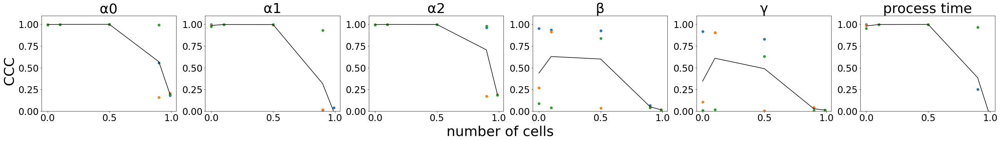

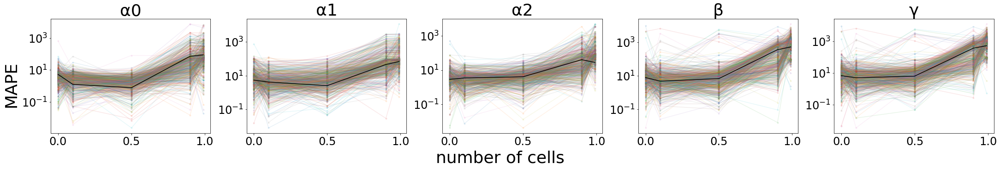

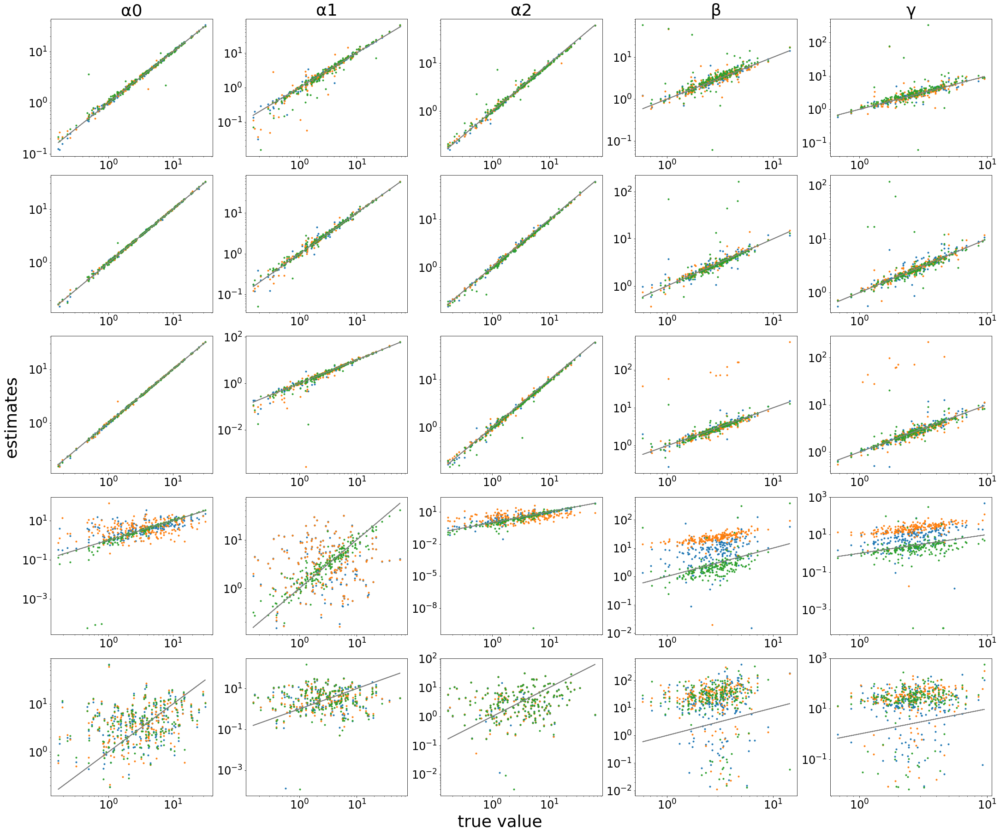

In [372]:
picklefile = results_dir+'vary_tp_topo_1_1.pickle'

plot_vary_results(picklefile=picklefile,xs=[0,0.1,0.5,0.9,0.99],K=3,logscale=False,Ub_correct=True)
fig = plot_theta_results(picklefile,K=3,Ub_correct=True)

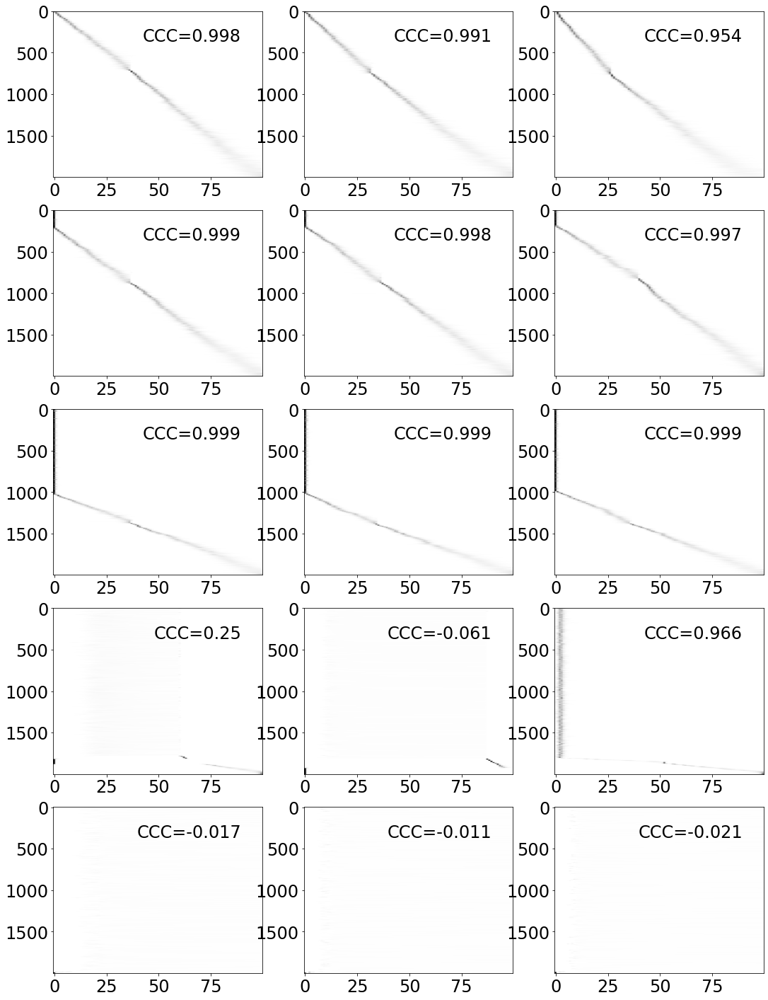

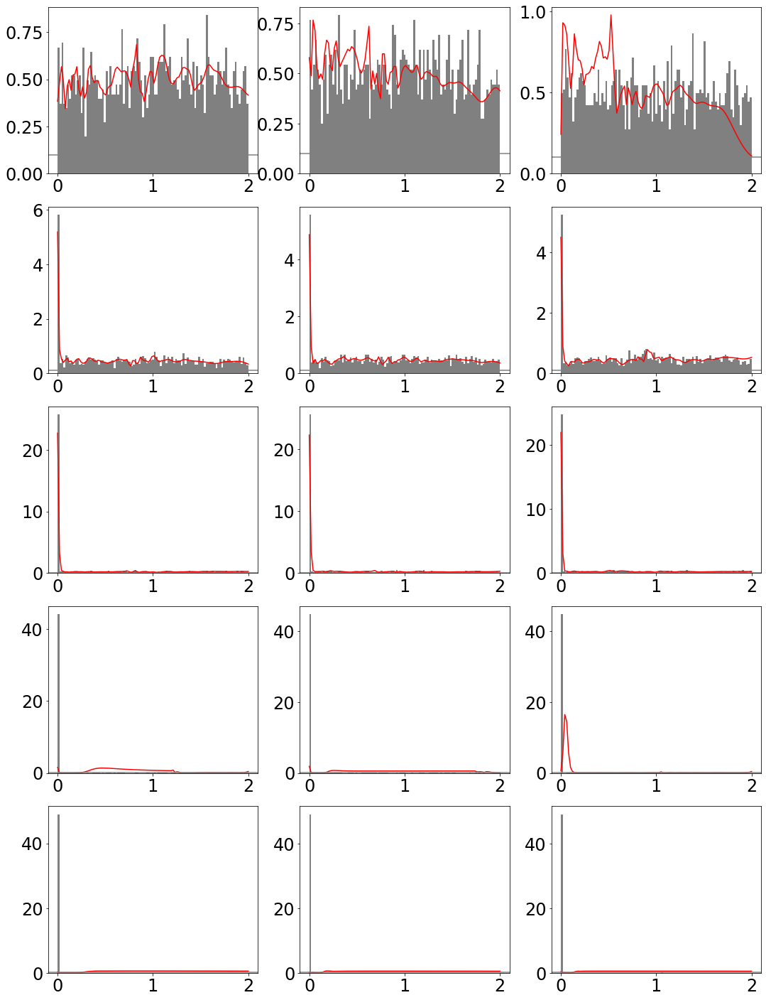

In [373]:
fig = plot_t_results(picklefile,K=3)

## 3 Gaussians with random means and varying sd

In [271]:
def vary_t_gaussian(topo, tau, true_tau=(0,0.75,2), t_sds=[1,0.1,0.001], n=2000, p=200, parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25, logu_mu=0, logu_sd=0):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if true_tau is None:
        true_tau = tau
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i, t_sd in enumerate(t_sds): 
        for k in range(K):
            np.random.seed(k)
            
            t1 = np.random.uniform(tau[0],tau[1],1)
            t3 = np.random.uniform(tau[1],tau[2],1)
            t2 = (t1+t3)/2
            t1_samples=np.random.normal(t1,t_sd,size=100*n)
            t2_samples=np.random.normal(t2,t_sd,size=100*n)
            t3_samples=np.random.normal(t3,t_sd,size=100*n)
            t_idx = (t1_samples>tau[0]) & (t2_samples>tau[0]) & (t3_samples>tau[0]) \
                    & (t1_samples<tau[-1]) & (t2_samples<tau[-1]) & (t3_samples<tau[-1])
            t_samples = np.concatenate((t1_samples[t_idx],t2_samples[t_idx],t3_samples[t_idx]))
            plt.figure()
            plt.hist(t_samples)
            
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,true_tau) # m*p*2
                true_t = np.append(true_t,t)
                
            if logu_sd > 0:
                Ubias = np.random.lognormal(logu_mu,logu_sd,p)
            else:
                Ubias = np.ones(p)*np.exp(logu_mu)
            Y[:,:,0] *= Ubias[None,:]
                
            if Er > 0:
                Z = Er*np.random.poisson(Y/Er)
            else:
                Z = Y.copy()
            
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
            X = np.random.poisson(rd[:,None,None]*Z)  
            
            params = {"r":X.mean((1,2))/X.mean(),'Ubias':Ubias}
            Input_args.append((X, topo, tau, true_t, theta, m, n_init, params, True))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
        
    return results

/tmp/ipykernel_1441068/4231816649.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


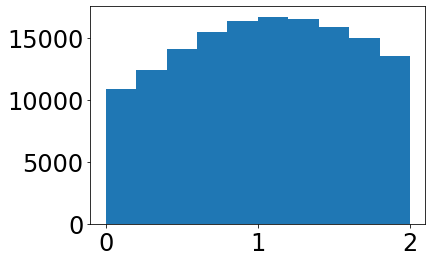

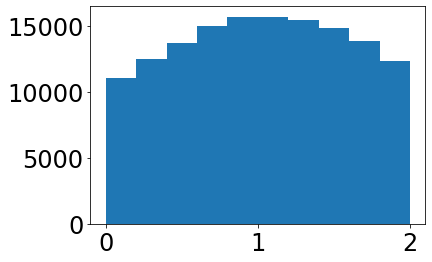

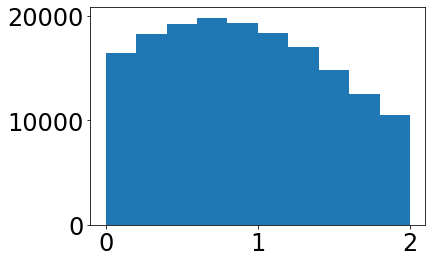

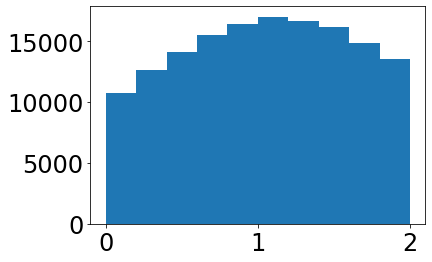

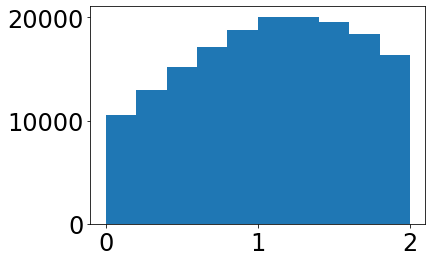

...

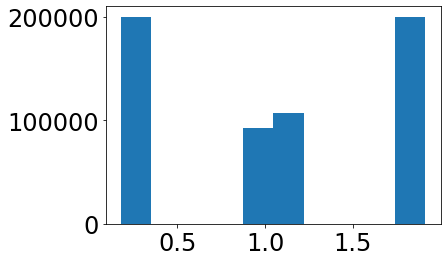

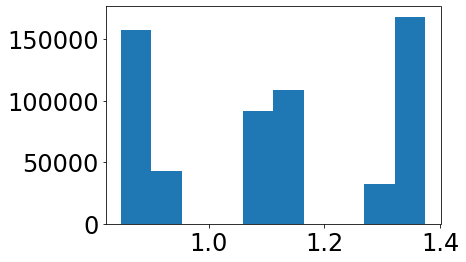

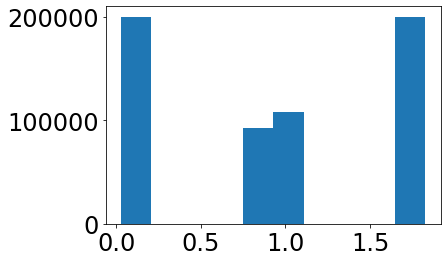

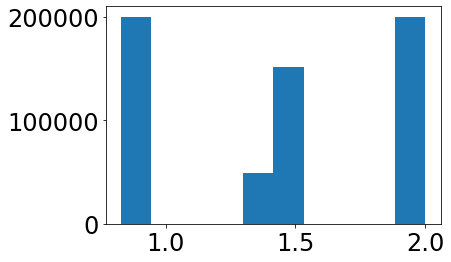

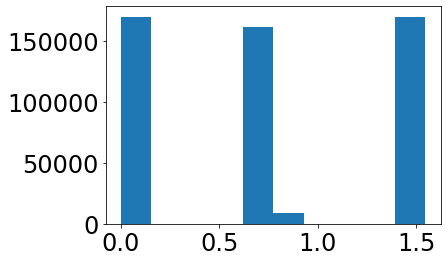

In [304]:
topo = np.array([[0,1,2]])
tau = (0,1,2)
results = vary_t_gaussian(topo, tau, true_tau=(0,0.75,2), t_sds=[1,0.5,0.1,0.01], n=2000, p=200,\
                      parameter_seed=1, K=10, n_init=10, epoch=100, m=100, cores=40,\
                      loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25, logu_mu=0, logu_sd=0)

with open(results_dir+'vary_tg_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

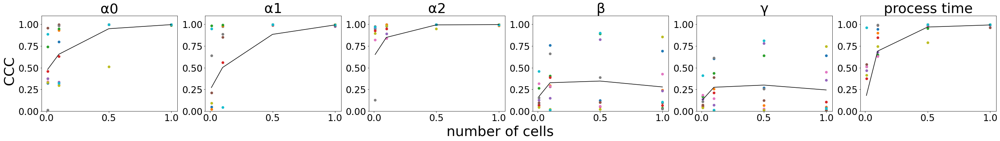

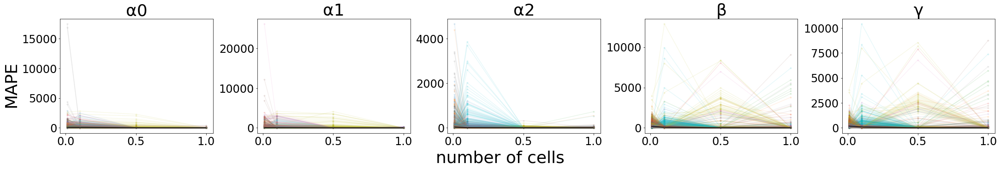

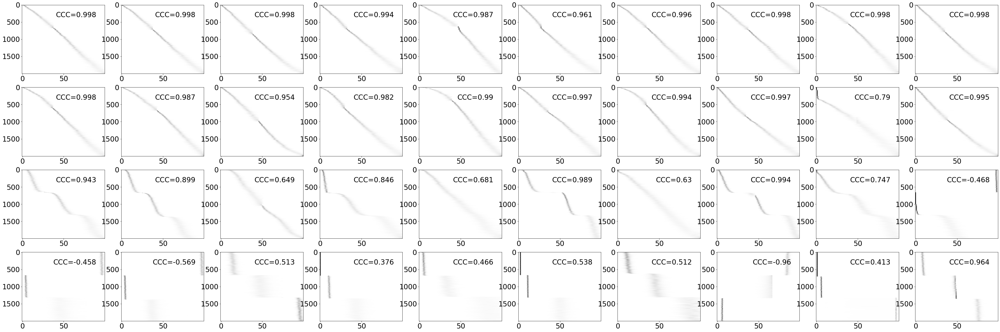

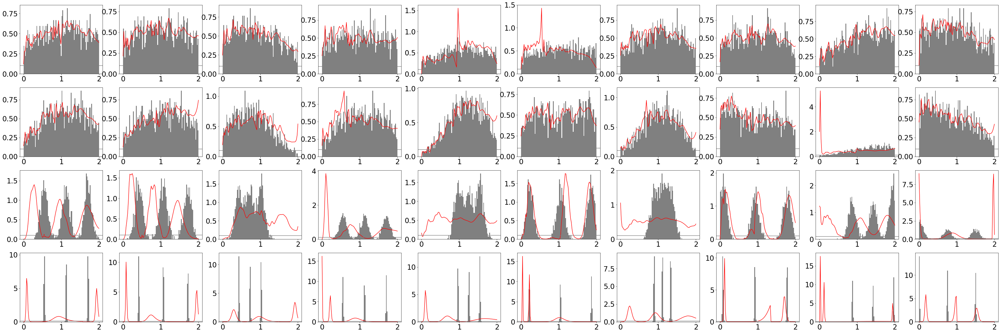

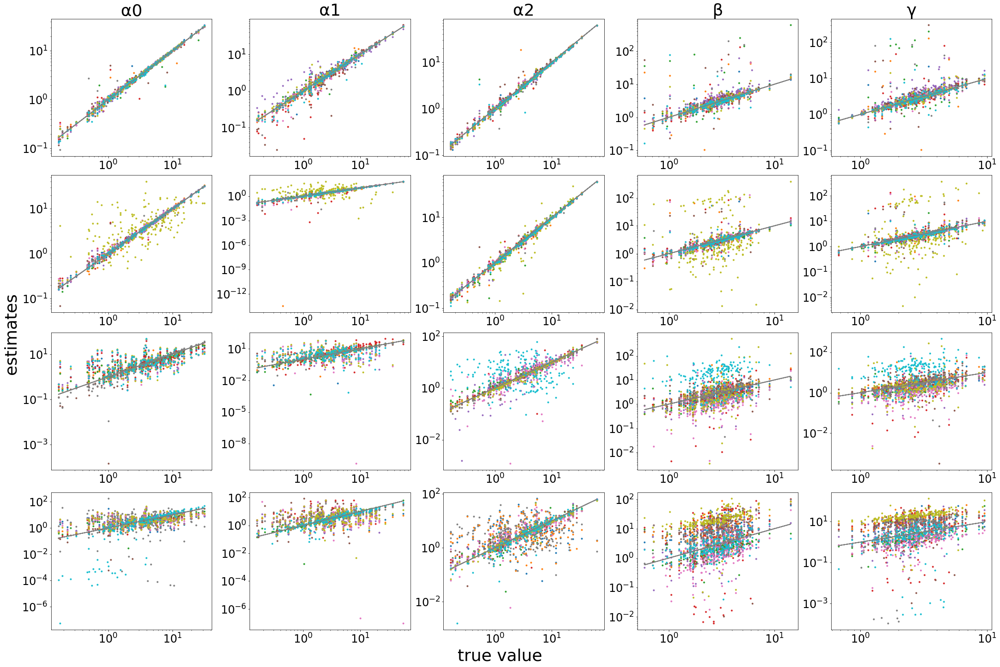

In [313]:
picklefile = results_dir+'vary_tg_topo_1_1.pickle'
K=10

plot_vary_results(picklefile=picklefile,xs=[1,0.5,0.1,0.01],K=K,logscale=False,Ub_correct=True)
fig = plot_t_results(picklefile,K=K)
fig = plot_theta_results(picklefile,K=K,Ub_correct=True)

## Random distributions

In [268]:
def vary_t_random(topo, tau, true_tau=None, t_percs=[0,0.1,0.5,0.9,0.99], n=2000, p=200, parameter_seed=1, K=3, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25, logu_mu=0, logu_sd=0):
    np.random.seed(parameter_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    true_t = []
    if true_tau is None:
        true_tau = tau
    
    theta=np.zeros((p,n_states+2))
    for j in range(n_states):
        theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
    theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
    theta[:,:n_states]/=theta[:,-2,None]
    
    Input_args = []
    for i, t_perc in enumerate(t_percs): 
        for k in range(K):
            np.random.seed(k)
            t_samples = np.random.uniform(true_tau[0],true_tau[-1],size=int(100*n))
            t_grids = np.random.uniform(true_tau[0],true_tau[-1],size=1001)
            t_prob = np.random.gamma(1/100,10,size=1001)
            t_prob /= t_prob.sum()
            t_samples[:int(100*n*t_perc)] = np.random.choice(t_grids,size=int(100*n*t_perc),p=t_prob)
            plt.figure()
            plt.hist(t_samples)
        
            true_t = []
            Y = np.zeros((n*L,p,2)) 
            for l in range(L):
                t = np.random.choice(t_samples,n)
                theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
                Y[l*n:(l+1)*n] = get_Y(theta_l,t,true_tau) # m*p*2
                true_t = np.append(true_t,t)
                
            if logu_sd > 0:
                Ubias = np.random.lognormal(logu_mu,logu_sd,p)
            else:
                Ubias = np.ones(p)*np.exp(logu_mu)
            Y[:,:,0] *= Ubias[None,:]
                
            if Er > 0:
                Z = Er*np.random.poisson(Y/Er)
            else:
                Z = Y.copy()
            
            if rd_var > 0:
                read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
                rd = read_depth/read_depth.mean()
            else:
                rd = np.ones(n*L)
            X = np.random.poisson(rd[:,None,None]*Z)  
            
            params = {"r":X.mean((1,2))/X.mean(),'Ubias':Ubias}
            Input_args.append((X, topo, tau, true_t, theta, m, n_init, params, True))
            
    with Pool(cores) as pool:      
        results = pool.starmap(fit_wrapper, Input_args, chunksize=1)
    
    return results

/tmp/ipykernel_1441068/1393912150.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


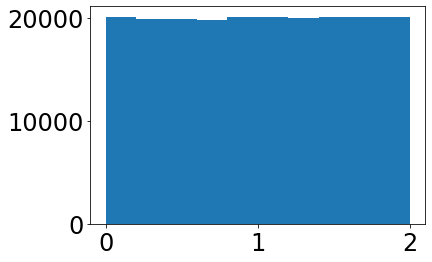

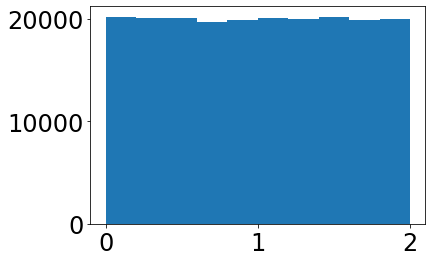

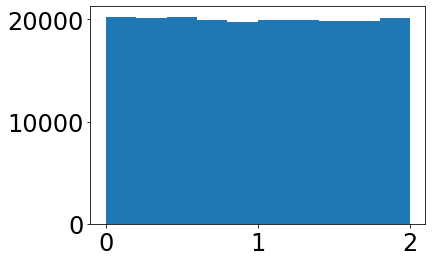

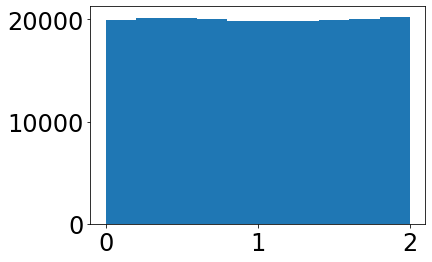

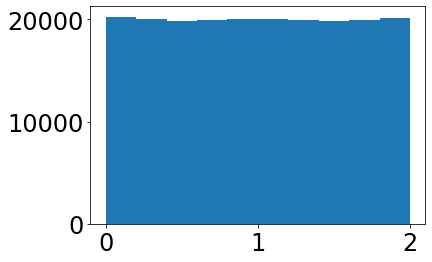

...

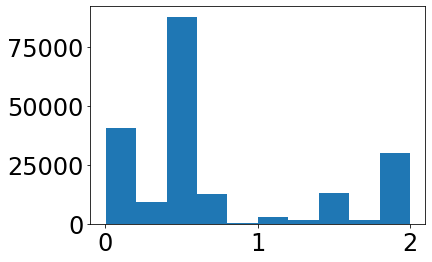

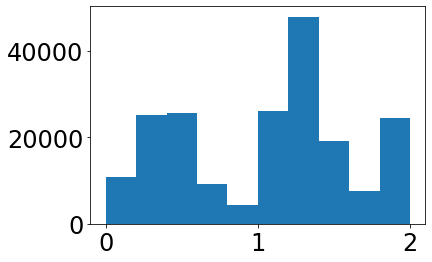

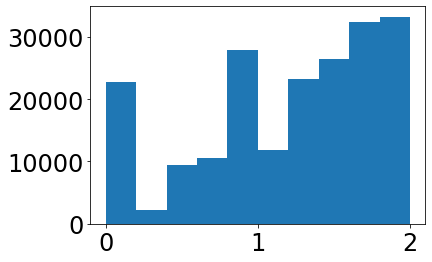

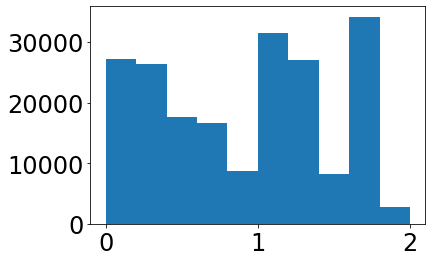

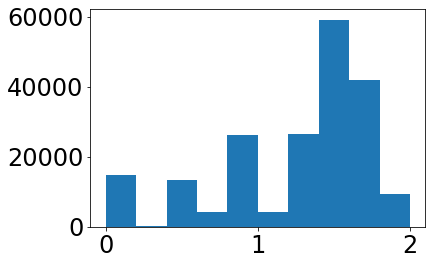

In [305]:
topo = np.array([[0,1,2]])
tau = (0,1,2)
results = vary_t_random(topo, tau, true_tau=(0,0.75,2), t_percs=[0,0.1,0.5,0.9,0.99], n=2000, p=200,\
                      parameter_seed=1, K=10, n_init=10, epoch=100, m=100, cores=50,\
                      loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, Er=0, rd_var=0.25, logu_mu=0, logu_sd=0)

with open(results_dir+'vary_tr_topo_1_1.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

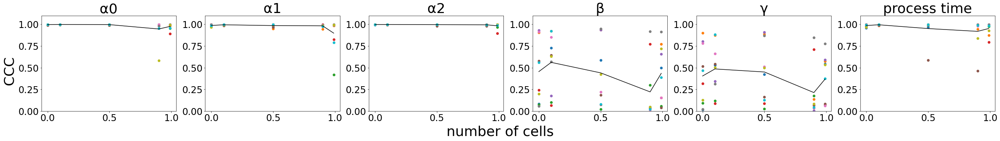

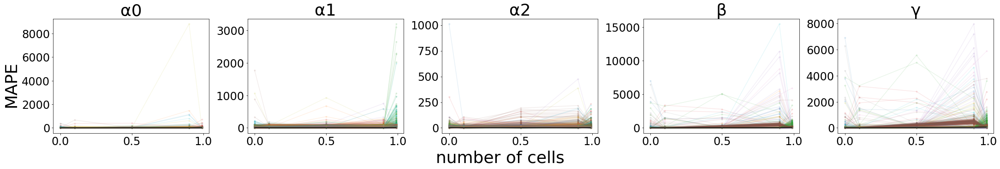

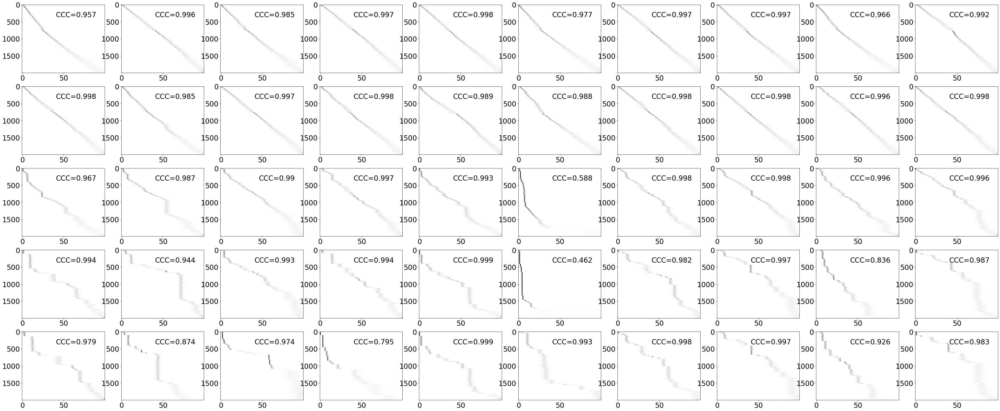

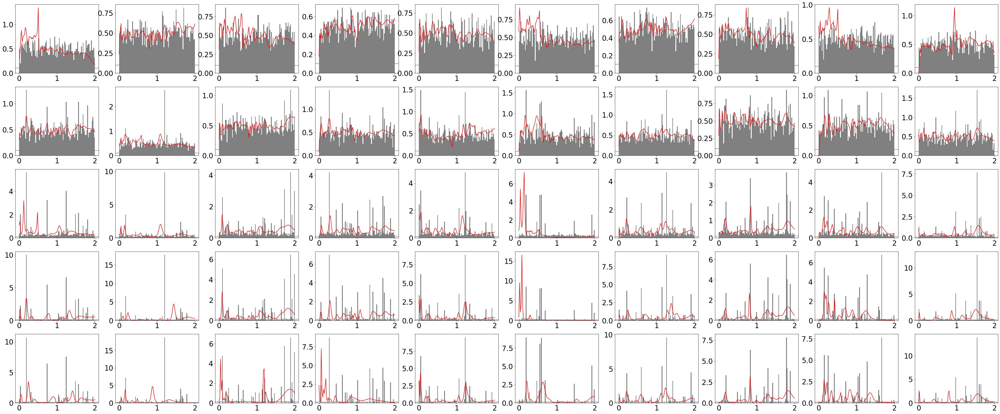

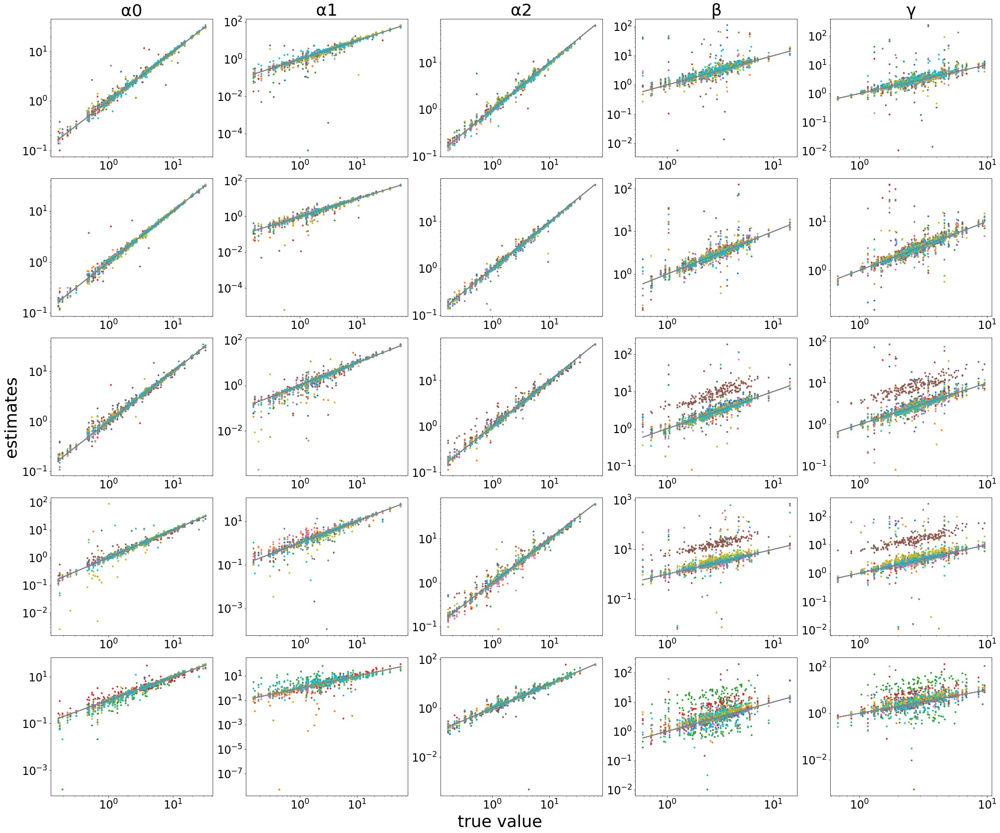

In [314]:
picklefile = results_dir+'vary_tr_topo_1_1.pickle'
K=10

plot_vary_results(picklefile=picklefile,xs=[0,0.1,0.5,0.9,0.99],K=K,logscale=False,Ub_correct=True)
fig = plot_t_results(picklefile,K=K)
fig = plot_theta_results(picklefile,K=K,Ub_correct=True)

# Model selection

## Topo and model

In [438]:
true_topo = np.array([[0,1,2]])
true_tau=(0,0.75,2)

topo_1 = np.array([[0,1,2]])
tau_1=(0,1.0,2)

topo_2 = np.array([[0,1,2,3]])
tau_2 = (0,0.1,1.5,2)
                      
def fit_model_wrapper(X, true_t, theta, params):
    traj0 = Trajectory(topo_1, tau_1, model="two_species_ss", verbose=0)
    traj0 = traj0.fit(X,params=params,fit_tau=True,n_init=10,epoch=100,parallel=False,n_threads=1)
    traj0.true_t = true_t
    traj0.true_topo = true_topo
    traj0.true_tau = true_tau
    traj0.true_theta = theta

    traj1 = Trajectory(topo_1, tau_1, model="two_species", verbose=0)
    traj1 = traj1.fit(X,params=params,fit_tau=True,n_init=10,epoch=100,parallel=False,n_threads=1)
    traj1.true_topo = true_topo
    traj1.true_tau = true_tau
    traj1.true_t = true_t
    traj1.true_theta = theta

    traj2 = Trajectory(topo_2, tau_2, model="two_species_ss", verbose=0)
    traj2 = traj2.fit(X,params=params,fit_tau=True,n_init=10,epoch=100,parallel=False,n_threads=1)
    traj2.true_t = true_t
    traj2.true_topo = true_topo
    traj2.true_tau = true_tau
    traj2.true_theta = theta

    return (traj0,traj1,traj2)

def vary_model_topo1(n=2000, p=200, t_samples=None, K=20, n_init=10, epoch=100, m=100, cores=15, loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25):        
    L=len(true_topo)
    n_states=len(set(true_topo.flatten()))
    if t_samples is None:
        t_samples=np.random.uniform(tau[0],tau[-1],size=100*n)

    Input_args = []
    for k in range(K):
        np.random.seed(k)                
        theta=np.zeros((p,n_states+2))
        for j in range(n_states):
            theta[:,j]=np.random.lognormal(loga_mu, loga_sd,size=p)
        theta[:,-2:]=np.random.lognormal(logb_mu,logb_sd,size=(p,2))
        theta[:,:n_states]/=theta[:,-2,None]

        true_t = []
        Y = np.zeros((n*L,p,2)) 
        for l in range(L):
            t = np.random.choice(t_samples,n)
            theta_l = np.concatenate((theta[:,topo[l]], theta[:,-2:]), axis=1)
            Y[l*n:(l+1)*n] = get_Y(theta_l,t,true_tau) # m*p*2
            true_t = np.append(true_t,t)

        if rd_var > 0:
            read_depth = np.random.gamma(1/rd_var,rd_var,n*L)
            rd = read_depth/read_depth.mean()
        else:
            rd = np.ones(n*L)

        X = np.random.poisson(rd[:,None,None]*Y)      

        params={'r':rd}
        Input_args.append((X, true_t, theta, params))
    
    with Pool(cores) as pool:      
        results = pool.starmap(fit_model_wrapper, Input_args, chunksize=1)
    
    return results


In [439]:
def plot_vary_results_(picklefile,xs,K=3,logscale=True,Ub_correct=False):
    with open(picklefile, 'rb') as f:
        results = pickle.load(f)
    assert len(results)//K == len(xs)
    
    p,n_theta = results[-1][0].true_theta.shape
    CCCs = np.zeros((len(results)//K,K,n_theta+1))
    MAPE = np.zeros((len(results)//K,K,p,n_theta))#Mean Absolute Percentage Error
    
    for i in range(len(results)):
        traj = results[i][0]
        true_theta = traj.true_theta.copy()
        Q = traj.Q
        p,n_theta = traj.theta.shape
        
        if len(traj.topo)==2:
            if np.sum(Q[:n,0])<np.sum(Q[:n,1]):
                true_theta[:,topo[0]] = traj.true_theta[:,topo[1]]
                true_theta[:,topo[1]] = traj.true_theta[:,topo[0]]
                
        if 'Ubias' in traj.params and Ub_correct is True:
            true_theta[:,:-2] *= traj.params['Ubias'][:,None]
            true_theta[:,-2] /= traj.params['Ubias']
            
        for j in range(n_theta):
            CCCs[i//K,i%K,j]=CCC(traj.theta[:,j],true_theta[:,j])
            
        CCCs[i//K,i%K,-1]=CCC(np.sum(traj.Q*traj.t[None,None,:],axis=(1,2)),traj.true_t)
        MAPE[i//K,i%K]=np.abs(traj.theta-true_theta)/true_theta*100

    fig, ax = plt.subplots(1,n_theta+1,figsize=((n_theta+1)*6,5),constrained_layout=True)
    for j in range(n_theta+1):
        for k in range(K):
            ax[j].scatter(xs,CCCs[:,k,j],alpha=1);
        ax[j].plot(xs,CCCs[:,:,j].mean(axis=1),alpha=1,color='k');
        if logscale:
            ax[j].set_xscale('log')
        
    for j in range(n_theta-2):
        ax[j].set_title("α"+str(j),fontsize=label_font)
        
    ax[-3].set_title("β",fontsize=label_font)
    ax[-2].set_title("γ",fontsize=label_font)
    ax[-1].set_title("process time",fontsize=label_font)
    
    plt.setp(ax, ylim=(0,1.1));
    fig.supylabel('CCC',fontsize=label_font);
    fig.supxlabel('number of cells',fontsize=label_font);
    
    fig, ax = plt.subplots(1,n_theta,figsize=(n_theta*6,5),constrained_layout=True)
    for j in range(n_theta):
        for pp in range(p):
            for k in range(K):
                ax[j].plot(xs,MAPE[:,k,pp,j],'.-',alpha=0.1);
                ax[j].set_yscale('log')
        ax[j].plot(xs,MAPE[:,:,pp,j].mean(axis=1),color='k',alpha=1);
        if logscale:
            ax[j].set_xscale('log')
    for j in range(n_theta-2):
        ax[j].set_title("α"+str(j),fontsize=label_font)
        
    ax[-2].set_title("β",fontsize=label_font)
    ax[-1].set_title("γ",fontsize=label_font)
    
    fig.supylabel('MAPE',fontsize=label_font);
    fig.supxlabel('number of cells',fontsize=label_font);

    return

In [335]:
results = vary_model_topo1(n=2000, p=200, t_samples=None, K=100,\
                           n_init=10, epoch=100, m=100, cores=50,\
                           loga_mu=2, loga_sd=1, logb_mu=1, logb_sd=0.5, rd_var=0.25)
with open(results_dir+'vary_model_topo_1_10000.pickle', 'wb') as f:
    pickle.dump(results, f, pickle.HIGHEST_PROTOCOL)

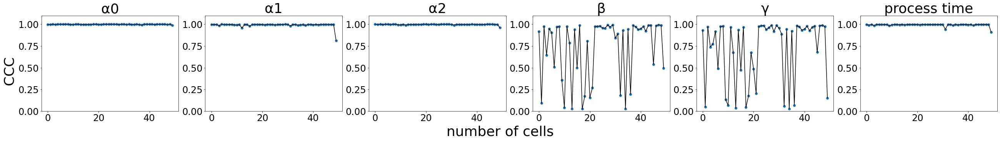

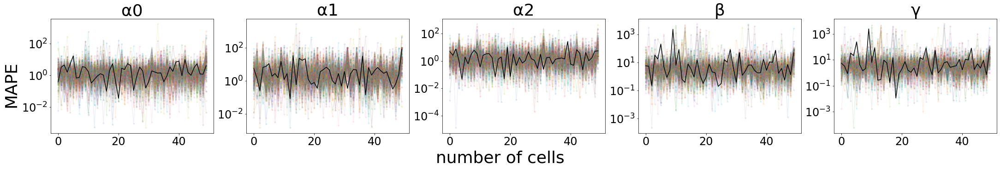

In [377]:
picklefile=results_dir+'vary_model_topo_1_10000.pickle'

plot_vary_results_(picklefile=picklefile,xs=np.arange(50),K=1,logscale=False)

In [378]:
def compute_IC(traj):
        """
        

        Parameters
        ----------
        X : TYPE
            DESCRIPTION.

        Returns
        -------
        None.

        """
        n, p, s = np.shape(traj.X)
        
        traj.k = traj.theta.size
        logL = traj.compute_lower_bound(traj.X)
        AIC = -2*n*logL +2*traj.k
        if n>traj.k:
            AICc = AIC + 2*traj.k*(traj.k+1)/(n-traj.k-1)
        else:
            raise ValueError('sample size too small') 
        BIC = -2*n*logL + traj.k * np.log(n)
        return  AICc, BIC

In [ ]:
with open(results_dir+'vary_model_topo_1_10000.pickle','rb') as f:
    results = pickle.load(f)
    
ELBO_y = []
ELBO_x = []
ELBO_true = []
ELBO_true_x = []
ELBO_true_y = []

for trajs in tqdm(results):
    traj = trajs[0]
    ELBO_x.append(traj.compute_lower_bound(traj.X))
    
    traj_true = Trajectory(traj.true_topo, traj.true_tau, model="two_species_ss", restrictions={}, verbose=0)
    traj_true = traj_true.fit(traj.X, warm_start=True, theta=traj.true_theta.copy(), params=traj.params, epoch=0)
    ELBO_true.append(traj_true.compute_lower_bound(traj.X))
    traj_true.fit(traj.X, warm_start=True, theta=traj.true_theta.copy(), params=traj.params, epoch=10)   
    ELBO_true_x.append(traj_true.compute_lower_bound(traj.X))
    
    Y = traj.get_Y_hat(traj.true_theta,traj.true_t,traj.true_tau,traj.true_topo,traj.params)[0]
    elbo_y = []
    elbo_true_y = []
    for k in range(10):
        X_Y = np.random.poisson(traj.params['r'][:,None,None]*Y)
        elbo_y.append(traj.compute_lower_bound(X_Y))
        elbo_true_y.append(traj_true.compute_lower_bound(X_Y))
    ELBO_y.append(np.mean(elbo_y))
    ELBO_true_y.append(np.mean(elbo_true_y))

  2%|▏         | 1/50 [01:40<1:21:40, 100.01s/it]

0.1851589784899943
0.2507845110845892


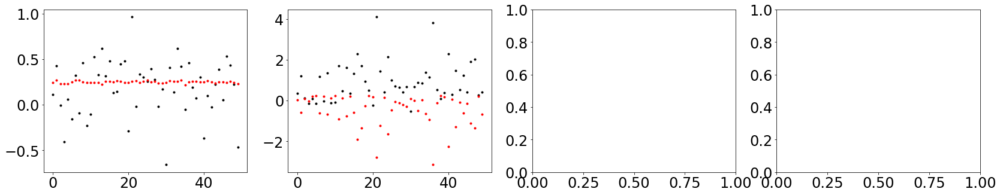

In [418]:
ELBO_true_y = np.array(ELBO_true_y)
ELBO_true_x = np.array(ELBO_true_x)
ELBO_true = np.array(ELBO_true)
ELBO_y = np.array(ELBO_y)
ELBO_x = np.array(ELBO_x)

print(np.mean(ELBO_true)-np.mean(ELBO_true_y))
print(np.mean(ELBO_true_x)-np.mean(ELBO_true))

fig,ax=plt.subplots(1,4,figsize=(28,5))
ax[0].plot(ELBO_true-ELBO_true_y,'k.');
ax[0].plot(ELBO_true_x-ELBO_true,'r.');

ax[1].plot(ELBO_true-ELBO_y,'k.');
ax[1].plot(ELBO_x-ELBO_true,'r.');

In [440]:
with open(results_dir+'vary_model_topo_1_10000.pickle','rb') as f:
    results = pickle.load(f)

ELBO_x = np.zeros((len(results),3))
for i,trajs in tqdm(enumerate(results)):
    for j,traj in enumerate(trajs):
        ELBO_x[i,j] = traj.compute_lower_bound(traj.X)

50it [00:24,  2.01it/s]


In [441]:
KK = 3
ELBO_y = np.zeros((len(results),3,KK))
        
for i,trajs in tqdm(enumerate(results)):
    traj = trajs[0]
    Y = traj.get_Y_hat(traj.true_theta,traj.true_t,traj.true_tau,traj.true_topo,traj.params)[0]            
    for k in range(KK):
        X_test = np.random.poisson(traj.params['r'][:,None,None]*Y)
        for j,traj in enumerate(trajs):
            ELBO_y[i,j,k] = traj.compute_lower_bound(X_test)

50it [02:12,  2.64s/it]


0.08740376782623116


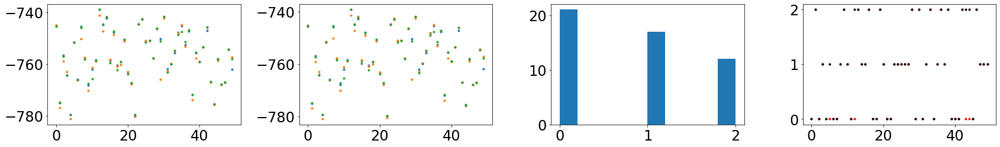

In [446]:
print(ELBO_x.mean()-ELBO_y.mean())
fig, ax = plt.subplots(1,4,figsize=(24,4),tight_layout=True)
ax[0].plot(ELBO_x,'.');
ax[1].plot(ELBO_y.mean((-1)),'.');
ax[2].hist(np.argmax(ELBO_y.mean((-1)),axis=1))
ax[3].plot(np.argmax(ELBO_y.mean((-1)),axis=1),'r.')
ax[3].plot(np.argmax(ELBO_x,axis=1),'k.')

In [422]:
with open(results_dir+'vary_model_topo_1_2000.pickle','rb') as f:
    results = pickle.load(f)

ELBO_x = np.zeros((len(results),3))
for i,trajs in tqdm(enumerate(results)):
    for j,traj in enumerate(trajs):
        ELBO_x[i,j] = traj.compute_lower_bound(traj.X)

50it [00:05,  9.89it/s]
50it [01:22,  1.65s/it]


In [436]:
KK = 100
ELBO_y = np.zeros((len(results),3,KK))
        
for i,trajs in tqdm(enumerate(results)):
    traj = trajs[0]
    Y = traj.get_Y_hat(traj.true_theta,traj.true_t,traj.true_tau,traj.true_topo,traj.params)[0]            
    for k in range(KK):
        X_test = np.random.poisson(traj.params['r'][:,None,None]*Y)
        for j,traj in enumerate(trajs):
            ELBO_y[i,j,k] = traj.compute_lower_bound(X_test)

50it [13:20, 16.02s/it]


0.4986867418460861


(array([17.,  0.,  0.,  0.,  0., 10.,  0.,  0.,  0., 23.]),
 array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <BarContainer object of 10 artists>)

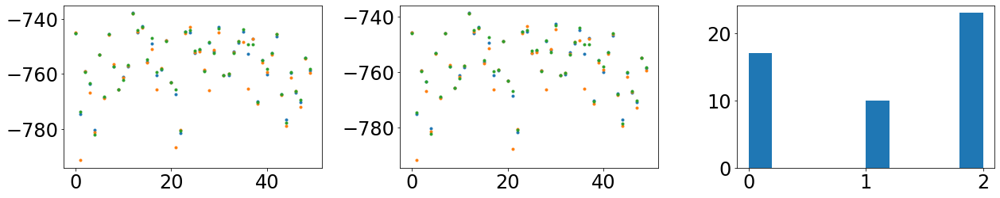

In [437]:
print(ELBO_x.mean()-ELBO_y.mean())
fig, ax = plt.subplots(1,3,figsize=(18,4),tight_layout=True)
ax[0].plot(ELBO_x,'.');
ax[1].plot(ELBO_y.mean((-1)),'.');
ax[2].hist(np.argmax(ELBO_y.mean((-1)),axis=1))

In [ ]:
x = []
y = []

for trajs in results:
    AIC = []
    BIC = []
    for traj in trajs:
        aic, bic = compute_IC(traj)
        AIC.append(aic)
        BIC.append(bic)
    print(AIC-np.min(AIC))
    x.append(np.argmin(AIC))
    y.append(np.argmin(BIC))
plt.hist([x,y])

[   0.          964.39509421 2254.7276591 ]
[  661.3193924  69816.03514075     0.        ]
[   0.         1827.85013208 3300.79811933]
[    0.         15093.17013107  1358.48682895]
[   0.         5703.01798578 9501.91287518]
[   0.         1878.84356165 2342.63184145]
[   0.         2817.88709848  552.5182044 ]
[   0.         2499.64616406 1672.97986916]
[1341.22390558    0.         3372.37749456]
[   0.         1343.25023615 1564.95140548]
[   0.         3227.97668085 6490.53327932]
[566.83109991 667.57283901   0.        ]
[   0.         2770.96669699 2827.63438228]
[1970.52589505 2161.32958954    0.        ]
[   0.         3537.63532454 2349.8225882 ]
[ 667.52065263 4660.43800356    0.        ]
[ 6091.80975617 15629.61239187     0.        ]
[ 3373.13929968 25405.44017771     0.        ]
[  0.         343.80652927 750.03345421]
[   0.         1858.29023806 2697.93145098]
[   0.         2046.38920332 1882.94259924]
[ 5028.06678054 83054.17662461     0.        ]
[2403.95027741    0.   

(array([[30.,  0.,  0.,  0.,  0.,  5.,  0.,  0.,  0., 15.],
        [27.,  0.,  0.,  0.,  0.,  7.,  0.,  0.,  0., 16.]]),
 array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <a list of 2 BarContainer objects>)

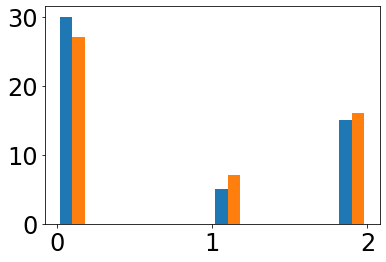

In [382]:
with open(results_dir+'vary_model_topo_1_2000.pickle','rb') as f:
    results = pickle.load(f)

x = []
y = []

for trajs in results:
    AIC = []
    BIC = []
    for traj in trajs:
        aic, bic = compute_IC(traj)
        AIC.append(aic)
        BIC.append(bic)
    print(AIC-np.min(AIC))
    x.append(np.argmin(AIC))
    y.append(np.argmin(BIC))
plt.hist([x,y])

## Non varying genes

In [18]:
import numpy as np

def simulate_data_with_null(topo, tau, n, p, null = 0.5, loga_max=4, logb_max=2, random_seed=42):
    np.random.seed(random_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    t=np.linspace(tau[0],tau[-1],n)
    true_t = []
    
    theta=np.zeros((p,n_states+4))
    for j in range(n_states+2):
        theta[:,j]=np.exp(np.random.uniform(0,loga_max,size=p))-1
    theta[:,-2]=np.exp(np.random.uniform(0,logb_max,size=p))
    theta[:,-1]=np.exp(np.random.uniform(0,logb_max,size=p))

    null_p = int(p*null)
    theta[:null_p,1]=theta[:null_p,0]
    theta[:null_p,-4]=theta[:null_p,0]
    theta[:null_p,-2]=1
    theta[:null_p,-1]=theta[:null_p,-4]/theta[:null_p,-3]

    Y = np.zeros((n*L,p,2))
    for l in range(L):
        theta_l = np.concatenate((theta[:,topo[l]], theta[:,-4:]), axis=1)
        Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
        true_t = np.append(true_t,t)

    X = np.random.poisson(Y)
    return theta, true_t, Y, X

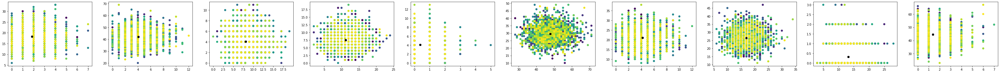

In [21]:
#%% generate data
topo = np.array([[0]])
tau = (0,1)
true_theta, t, Y, X = simulate_data_with_null(topo,tau,n=2000,p=200,random_seed=2023)

t = np.linspace(0,1,2000)
plot_p = 10
fig, ax = plt.subplots(1,plot_p,figsize=(6*plot_p,4))
for i in range(plot_p):
    j = 90 + i
    ax[i].scatter(X[:,j,0],X[:,j,1],c=t);
    ax[i].scatter(Y[:,j,0],Y[:,j,1],c='black');


In [20]:
traj = Trajectory(topo, tau)
res = traj.fit_multi_init(X,100,n_init=2,epoch=10,parallel=True,n_threads=2)

trial 1


100%|██████████| 10/10 [00:20<00:00,  2.08s/it]

trial 2



100%|██████████| 10/10 [00:17<00:00,  1.73s/it]


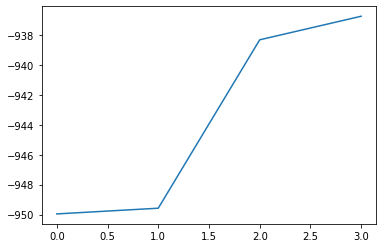

In [22]:
Q, elbos = res
plt.plot(elbos);

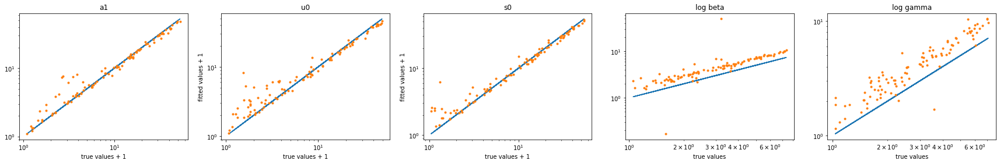

In [23]:
plot_theta(true_theta[100:],traj.theta[100:])

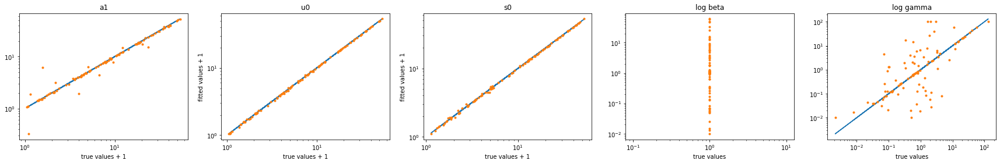

In [24]:
plot_theta(true_theta[:100],traj.theta[:100])

In [ ]:
plot_phase(X,traj.theta[:20],Q,topo,tau)

In [25]:
accepts = []
diffs = []
true_positive = 0
for j in range(100):
    nested_model = {j:[[0,-3],[-4,-4]]}
    accept, diff = traj.compare_model(X, nested_model)
    true_positive += accept
    accepts.append(accept)
    diffs.append(diff)


In [28]:
accepts = []
diffs = []
false_positive = 0
for j in range(100,200):
    nested_model = {j:[[0,-3],[-4,-4]]}
    accept, diff = traj.compare_model(X, nested_model)
    false_positive += accept
    accepts.append(accept)
    diffs.append(diff)


In [29]:
true_positive,false_positive

(95, 0)

## Partially changing genes

In [ ]:
import numpy as np

def simulate_data_with_partial_null(topo, tau, n, p, null_p = 10, loga_max=4, logb_max=2, random_seed=42):
    np.random.seed(random_seed)
    L=len(topo)
    n_states=len(set(topo.flatten()))
    assert n_states > 1
    t=np.linspace(tau[0],tau[-1],n)
    true_t = []
    
    theta=np.zeros((p,n_states+4))
    for j in range(n_states+2):
        theta[:,j]=np.exp(np.random.uniform(0,loga_max,size=p))-1
    theta[:,-2]=np.exp(np.random.uniform(0,logb_max,size=p))
    theta[:,-1]=np.exp(np.random.uniform(0,logb_max,size=p))

    theta[:null_p,1]=theta[:null_p,0]

    Y = np.zeros((n*L,p,2))
    for l in range(L):
        theta_l = np.concatenate((theta[:,topo[l]], theta[:,-4:]), axis=1)
        Y[l*n:(l+1)*n] = get_Y(theta_l,t,tau) # m*p*2
        true_t = np.append(true_t,t)

    X = np.random.poisson(Y)
    return theta, true_t, Y, X

In [ ]:
#%% generate data
topo = np.array([[0,1]])
tau = (0,0.5,1)
true_theta, t, Y, X = simulate_data_with_partial_null(topo,tau,n=2000,p=100,random_seed=2023)

p = 20
fig, ax = plt.subplots(1,p,figsize=(6*p,4))
for i in range(p):
    ax[i].set_title(str(i));
    ax[i].scatter(X[:,i,0],X[:,i,1],c=t);
    ax[i].scatter(Y[:,i,0],Y[:,i,1],c='black');
# time increases from blue to yellow

In [ ]:
traj = Trajectory(topo, tau)
res = traj.fit_multi_init(X,100,n_init=10,epoch=10,parallel=True,n_threads=2)

In [ ]:
Q, elbos, thetas = res
plt.plot(elbos);

In [ ]:
plot_theta(true_theta[10:],traj.theta[10:])

In [ ]:
plot_phase(X,traj.theta[:20],Q,topo,tau)

In [ ]:
accepts = []
diffs = []
for j in range(20):
    nested_model = {j:[[1],[0]]}
    accept, diff = traj.compare_model(X, nested_model, parallel=True, n_threads=2)
    accepts.append(accept)
    diffs.append(diff)

In [ ]:
plt.plot(accepts);

In [ ]:
plot_phase(X,traj.new_theta[:20],Q,topo,tau)

In [ ]:
plt.plot(diffs)